# Combined Panel Clustering and Label Propogation
**Author: Christopher Z. Eddy (eddyc@ohsu.edu)** \
**Purpose:** Combined panels may be used to determine multiplexed delineated cell-types, enriching our ability to phenotype cells compared to individual panels alone. Specifically, only cells that are tracked, or appear in both panels, can be used to de novo discover these multiplexed cell-types. In this worksheet, I first normalize individual panel (immune and tumor) marker expression values. I then cluster each panel to identify single-plex cell types within the entire tumor and immune datasets. After, I use the tracked cells' normalized marker expressions to cluster and identify multiplexed cell types, ideally revealing further stratification of individual panel cell types. After identifying multiplexed cell types, I use a KNN (K=10) algorithm to propogate multiplexed labels to untracked cells within each individual panel. Finally, I provide a host of visualizations including UMAPs and heatmaps to visualize available metadata, clusters, and marker expression values within the dataset. I additionally provide Sankey diagram visualizations to investigate our ability to further stratify individual panel cell types to multiplexed cell types. \
**Notes:** Here, I take advantage of GPU resources to accelerate computation on large datasets. 

# CLUSTERING SEPARATE AND COMBINED PANELS!
Use rapids-22.08 environment for this

## IMPORT LIBRARIES

In [1]:
import cupy
cupy.show_config()

OS                           : Linux-3.10.0-1160.66.1.el7.x86_64-x86_64-with-glibc2.17
Python Version               : 3.9.15
CuPy Version                 : 10.6.0
CuPy Platform                : NVIDIA CUDA
NumPy Version                : 1.22.4
SciPy Version                : 1.9.3
Cython Build Version         : 0.29.30
Cython Runtime Version       : None
CUDA Root                    : /home/groups/CEDAR/eddyc/packages/miniconda/envs/rapids-22.08
nvcc PATH                    : None
CUDA Build Version           : 11020
CUDA Driver Version          : 12040
CUDA Runtime Version         : 11070
cuBLAS Version               : (available)
cuFFT Version                : 10702
cuRAND Version               : 10210
cuSOLVER Version             : (11, 3, 5)
cuSPARSE Version             : (available)
NVRTC Version                : (11, 7)
Thrust Version               : 101000
CUB Build Version            : 101000
Jitify Build Version         : 87d8ccd
cuDNN Build Version          : None
cuDNN Versio

In [1]:
import numpy as np 
import pandas as pd
from scipy.spatial.distance import cdist
# import scanpy as sc
# import anndata
import process_data

import cuml
import cudf
import grapheno_ce

In [2]:
def pad_with_zero(entry):
    # Extract the letter and numeric parts
    letter = entry[0]
    number = entry[1:]
    
    # If the number part has only one digit, pad with 0
    if len(number) == 1:
        number = '0' + number
        
    return letter + number

## Run the following if you have not clustered the data already

## READ IN DATA

In [3]:
breast_cancer_cores = ['A08','H08','G09','E05','C01', 'D02', 'G03', 'B09', 'A05', 'B10', 'H07', 'H03', 'G07',
              'F02','H02', 'E08', 'A10', 'B03', 'H06', 'E10', 'G01', 'E06', 'C10', 'B07', 'D08', 'E09',
              'F07', 'E03', 'F01', 'B06', 'B01', 'A06', 'H10', 'H04']

In [13]:
tumor_all = pd.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tumor_all.csv", delimiter=",")
tumor_all = tumor_all.loc[:, ~tumor_all.columns.str.contains("Unnamed")]
tumor_all['core'] = tumor_all['core'].apply(pad_with_zero)
#remove any rows whose cores are not in breast_cancer_cores
tumor_all = tumor_all.loc[tumor_all['core'].str.contains('|'.join(breast_cancer_cores))]
tumor_all.set_index(["CellID", "core"], inplace=True)
print("Tumor All Shape = {}".format(tumor_all.shape))
tumor_all.head()

Tumor All Shape = (327437, 25)


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,p21,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31
CellID,core,,,,,,,,,,,,,,,,,,,,,
2,A10,22270.374233,951.724868,1267.803681,534.518519,848.809816,70.354497,558.222222,833.947090,1032.232804,273.042328,...,516.037037,650.275132,252.587302,774.719577,722.282209,224.730061,635.582822,1158.705521,168.084656,1214.407407
4,A10,15830.266667,1234.049383,3098.483333,5068.407407,801.266667,94.790123,547.259259,1023.654321,1087.148148,348.703704,...,693.728395,673.827160,1748.987654,346.271605,855.650000,233.166667,636.283333,1145.750000,747.753086,1221.987654
5,A10,7079.833333,1084.604651,2163.250000,3313.418605,740.416667,75.488372,562.372093,912.651163,856.279070,270.511628,...,619.767442,647.534884,540.860465,335.418605,869.333333,215.250000,631.000000,1159.500000,5475.302326,1208.139535
6,A10,17536.438017,1641.845638,5130.487603,10677.677852,1883.661157,239.812081,1276.362416,1944.194631,2069.442953,732.268456,...,788.543624,746.550336,4288.328859,602.281879,986.198347,242.322314,654.066116,1130.033058,2469.161074,1229.134228
7,A10,10007.493827,1000.728395,1101.592593,1242.345679,684.049383,73.567901,496.370370,842.925926,853.407407,249.925926,...,568.197531,633.469136,314.135802,701.913580,874.333333,225.000000,638.185185,1158.160494,379.456790,1247.395062


In [14]:
immune_all = pd.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/immune_all.csv", delimiter=",")
immune_all = immune_all.loc[:, ~immune_all.columns.str.contains("Unnamed")]
immune_all['core'] = immune_all['core'].apply(pad_with_zero)
#remove any rows whose cores are not in breast_cancer_cores
immune_all = immune_all.loc[immune_all['core'].str.contains('|'.join(breast_cancer_cores))]
immune_all.set_index(["CellID", "core"], inplace=True)
print("Immune All Shape = {}".format(immune_all.shape))
immune_all.head()

Immune All Shape = (320099, 25)


,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,PDL1_2,CD11b,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1
CellID,core,,,,,,,,,,,,,,,,,,,,,
1,A10,12514.166667,1310.130952,482.619048,870.857143,945.750000,11337.928571,866.654762,885.130952,696.380952,526.500000,...,1170.976190,1234.214286,495.250000,1307.130952,617.750000,267.535714,701.750000,1395.666667,116.702381,580.261905
2,A10,3672.533333,702.055556,222.833333,807.500000,693.066667,305.055556,837.444444,740.111111,499.166667,546.777778,...,1147.277778,1056.833333,375.466667,1187.388889,693.733333,279.277778,549.388889,1412.666667,99.000000,583.722222
3,A10,27140.375000,1364.403101,459.294574,872.414729,992.041667,18913.577519,872.934109,940.922481,781.100775,643.453488,...,1163.399225,1209.841085,453.472222,1292.182171,865.215278,324.395349,721.856589,1545.381944,122.697674,648.972868
4,A10,16410.609023,1345.702811,502.787149,914.333333,973.353383,31702.795181,887.618474,918.108434,814.160643,705.128514,...,1186.116466,1214.554217,475.293233,1316.481928,2029.706767,452.240964,1010.779116,1779.421053,159.855422,691.718876
5,A10,15995.353448,1143.067708,430.750000,895.369792,831.698276,19587.005208,861.765625,841.218750,706.744792,672.666667,...,1168.203125,1247.312500,432.008621,1248.020833,1288.189655,355.010417,822.171875,1519.198276,122.078125,702.838542


In [15]:
tumor_all_ind = tumor_all.index
immune_all_ind = immune_all.index

#### Grab the tracked cell data
When we normalize and remove cells beyond the 99.9th percentile, we want to similarly remove those cells from the tracked set, if they exist within it.

In [7]:
tumor_tracked = pd.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tumor_tracked.csv")
tumor_tracked = tumor_tracked.loc[:, ~tumor_tracked.columns.str.contains("Unnamed")]
tumor_tracked['core'] = tumor_tracked['core'].apply(pad_with_zero)
#remove any rows whose cores are not in breast_cancer_cores
tumor_tracked = tumor_tracked.loc[tumor_tracked['core'].str.contains('|'.join(breast_cancer_cores))]
tumor_tracked['CellID'] = tumor_tracked['CellID'].astype(int)
tumor_tracked.set_index(["CellID","core"], inplace=True)
immune_tracked = pd.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/immune_tracked.csv", delimiter=",")
immune_tracked = immune_tracked.loc[:, ~immune_tracked.columns.str.contains("Unnamed")]
immune_tracked['core'] = immune_tracked['core'].apply(pad_with_zero)
#remove any rows whose cores are not in breast_cancer_cores
immune_tracked = immune_tracked.loc[immune_tracked['core'].str.contains('|'.join(breast_cancer_cores))]
immune_tracked['CellID'] = immune_tracked['CellID'].astype(int)
immune_tracked.set_index(["CellID","core"], inplace=True)


In [8]:
tumor_tracked.head()

,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,p21,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31
CellID,core,,,,,,,,,,,,,,,,,,,,,
4,A10,15830.266667,1234.049383,3098.483333,5068.407407,801.266667,94.790123,547.259259,1023.654321,1087.148148,348.703704,...,693.728395,673.827160,1748.987654,346.271605,855.650000,233.166667,636.283333,1145.750000,747.753086,1221.987654
16,A10,19406.048780,1686.346154,3588.674797,9804.753846,699.544715,76.346154,531.084615,839.115385,887.346154,255.030769,...,600.723077,640.938462,390.861538,1315.815385,828.439024,216.723577,617.447154,1162.000000,418.315385,1239.307692
7,A10,10007.493827,1000.728395,1101.592593,1242.345679,684.049383,73.567901,496.370370,842.925926,853.407407,249.925926,...,568.197531,633.469136,314.135802,701.913580,874.333333,225.000000,638.185185,1158.160494,379.456790,1247.395062
23,A10,4845.724638,978.421053,1085.507246,1168.118421,706.565217,78.763158,493.894737,853.763158,858.565789,260.460526,...,589.000000,638.039474,419.302632,929.894737,790.797101,221.521739,630.608696,1166.159420,415.381579,1209.855263
20,A10,19335.553719,1868.718954,3923.619835,10203.411765,2691.438017,229.241830,1501.973856,4281.581699,3210.699346,974.411765,...,1309.575163,968.816993,12681.686275,553.156863,1706.933884,297.008264,704.190083,1346.247934,19682.784314,1227.098039


In [7]:
immune_tracked.head()

,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,PDL1_2,CD11b,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1
CellID,core,,,,,,,,,,,,,,,,,,,,,
5,A10,15995.353448,1143.067708,430.750000,895.369792,831.698276,19587.005208,861.765625,841.218750,706.744792,672.666667,...,1168.203125,1247.312500,432.008621,1248.020833,1288.189655,355.010417,822.171875,1519.198276,122.078125,702.838542
8,A10,23299.158416,1256.446667,421.366667,861.433333,913.881188,12921.046667,871.786667,915.620000,770.400000,669.640000,...,1147.306667,1236.253333,466.297030,1340.753333,698.920792,271.606667,546.360000,1469.128713,112.186667,591.766667
10,A10,15409.591304,975.563291,330.025316,832.797468,787.834783,5636.955696,838.417722,821.993671,610.044304,584.594937,...,1141.082278,1153.930380,397.226087,1213.044304,832.556522,411.335443,817.740506,1495.730435,115.898734,632.405063
18,A10,18929.089172,1331.607843,518.215686,883.867647,944.235669,21137.519608,897.696078,991.323529,824.289216,670.877451,...,1156.024510,1551.191176,448.286624,1325.598039,720.770701,293.921569,623.465686,1352.216561,104.838235,557.303922
23,A10,23559.511628,1525.721519,559.430380,921.637131,951.658915,21918.900844,902.160338,949.700422,837.953586,809.936709,...,1205.983122,1269.440928,450.794574,1332.949367,2158.961240,470.426160,1281.546414,1663.058140,147.677215,682.497890


In [16]:

print("Number of tumor cells/features = {}/{}".format(tumor_all.shape[0], tumor_all.shape[1]))
print("Number of immune cells/features = {}/{}".format(immune_all.shape[0], immune_all.shape[1]))

Number of tumor cells/features = 327437/25
Number of immune cells/features = 320099/25


## Visualize the distributions of the markers! Clean and normalize the data, remove outliers!

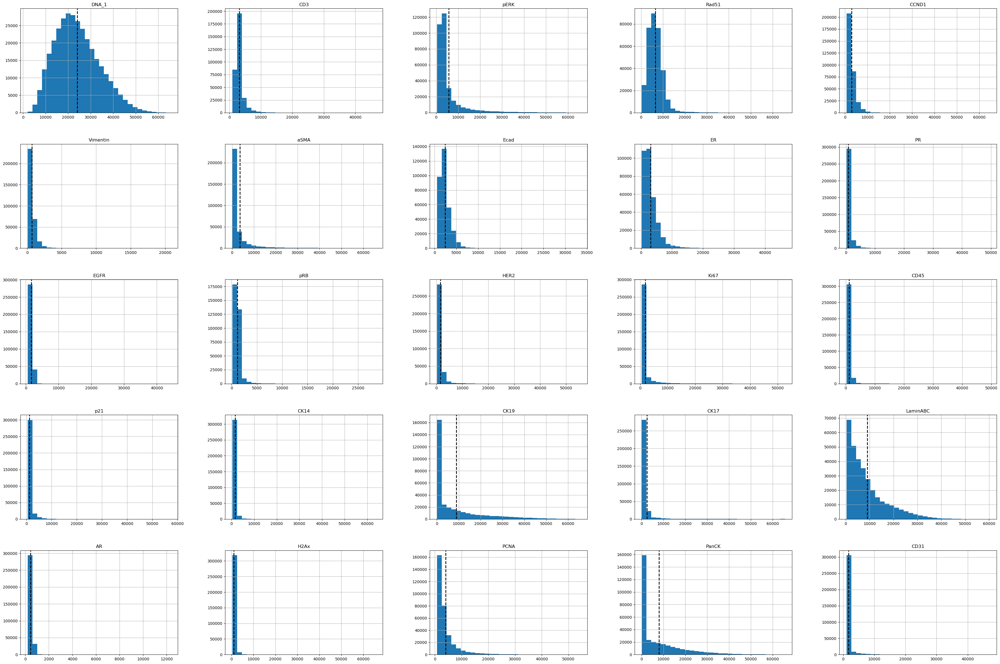

In [21]:
process_data.visualize_hists(tumor_all,plot_mean=True, exclude_list = ['CellID', 'core'])

In [17]:
# CLEAN and normalize data from immune and tumor datasets!
tumor_all = process_data.normalize_dataframe(tumor_all, remove_outliers = True, log_transform = True, ignore_cols = ['CellID', 'core'])
immune_all = process_data.normalize_dataframe(immune_all, remove_outliers = True, log_transform = True, ignore_cols = ['CellID', 'core'])
print("AFTER REMOVING OUTLIERS:")
print("Number of tumor cells/features = {}/{}".format(tumor_all.shape[0], tumor_all.shape[1]))
print("Number of immune cells/features = {}/{}".format(immune_all.shape[0], immune_all.shape[1]))

Data shape = (320148, 25)
total preprocessing time = 0.03136358261108398 minutes
Data shape = (313106, 25)
total preprocessing time = 0.028941877683003745 minutes
AFTER REMOVING OUTLIERS:
Number of tumor cells/features = 320148/25
Number of immune cells/features = 313106/25


#### Visualize the changes to the histogram!

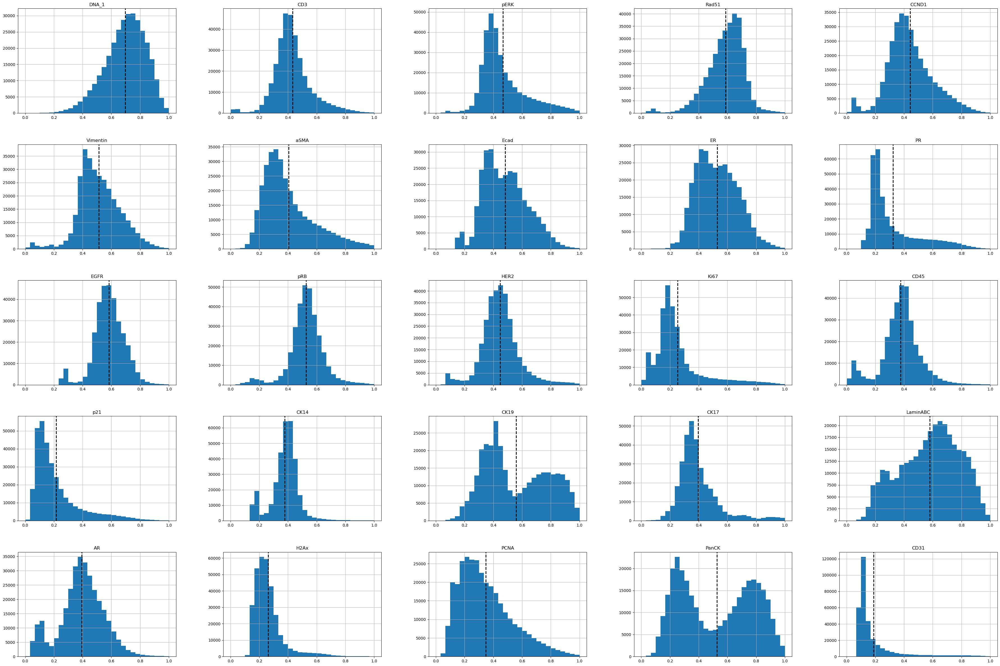

In [23]:
process_data.visualize_hists(tumor_all,plot_mean=True)

## Search for possible reptitions in the dataset

In [11]:
cores = tumor_all.index.get_level_values('core').unique().tolist()
for i in range(len(cores)):
    for j in range(i+1, len(cores)):
        num_combined = tumor_all.loc[tumor_all.index.get_level_values('core').isin([cores[i], cores[j]])].shape[0]
        wo_dups = tumor_all.loc[tumor_all.index.get_level_values('core').isin([cores[i], cores[j]])].drop_duplicates().shape[0]
        if num_combined != wo_dups:
            print("POSSIBLE DUPLICATES : {}, {}, fraction of overlaps = {} percent".format(cores[i], cores[j], (2 - (2 * wo_dups/num_combined))*100))

## Write tumor and immune panels to individual files for independent clustering later

In [24]:
# Write to csv
tumor_all.reset_index().to_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/tumor_all.csv", index=False)
immune_all.reset_index().to_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/immune_all.csv", index=False)

## For cells that were removed during normalization from each panel, also remove them from the tracked data

In [18]:
#determine which rows were removed from the datasets; remove the same rows from immune_tracked and tumor_tracked
rm_from_tumor_all = tumor_all_ind.difference(tumor_all.index)
rm_from_immune_all = immune_all_ind.difference(immune_all.index)

bad_inds_tumor_tracked = tumor_tracked.index.isin(rm_from_tumor_all)
bad_inds_immune_tracked = immune_tracked.index.isin(rm_from_immune_all)
bad_inds = np.logical_or(bad_inds_tumor_tracked, bad_inds_immune_tracked) #drop any rows that are True.


In [19]:
print("Tumor tracked # cells / # features before removal of outliers: {}/{}".format(tumor_tracked.shape[0], tumor_tracked.shape[1]))
tumor_tracked.drop(tumor_tracked.index[bad_inds].tolist(),inplace=True)
print("Tumor tracked # cells / # features after removal of outliers: {}/{}".format(tumor_tracked.shape[0], tumor_tracked.shape[1]))

Tumor tracked # cells / # features before removal of outliers: 152355/25
Tumor tracked # cells / # features after removal of outliers: 146226/25


In [20]:
print("Immune tracked # cells / # features before removal of outliers: {}/{}".format(immune_tracked.shape[0], immune_tracked.shape[1]))
immune_tracked.drop(immune_tracked.index[bad_inds].tolist(),inplace=True)
print("Immune tracked # cells / # features after removal of outliers: {}/{}".format(immune_tracked.shape[0], immune_tracked.shape[1]))

Immune tracked # cells / # features before removal of outliers: 152355/25
Immune tracked # cells / # features after removal of outliers: 146226/25


In [21]:
tumor_tracked.head()

,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,p21,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31
CellID,core,,,,,,,,,,,,,,,,,,,,,
4,A10,15830.266667,1234.049383,3098.483333,5068.407407,801.266667,94.790123,547.259259,1023.654321,1087.148148,348.703704,...,693.728395,673.827160,1748.987654,346.271605,855.650000,233.166667,636.283333,1145.750000,747.753086,1221.987654
16,A10,19406.048780,1686.346154,3588.674797,9804.753846,699.544715,76.346154,531.084615,839.115385,887.346154,255.030769,...,600.723077,640.938462,390.861538,1315.815385,828.439024,216.723577,617.447154,1162.000000,418.315385,1239.307692
7,A10,10007.493827,1000.728395,1101.592593,1242.345679,684.049383,73.567901,496.370370,842.925926,853.407407,249.925926,...,568.197531,633.469136,314.135802,701.913580,874.333333,225.000000,638.185185,1158.160494,379.456790,1247.395062
23,A10,4845.724638,978.421053,1085.507246,1168.118421,706.565217,78.763158,493.894737,853.763158,858.565789,260.460526,...,589.000000,638.039474,419.302632,929.894737,790.797101,221.521739,630.608696,1166.159420,415.381579,1209.855263
20,A10,19335.553719,1868.718954,3923.619835,10203.411765,2691.438017,229.241830,1501.973856,4281.581699,3210.699346,974.411765,...,1309.575163,968.816993,12681.686275,553.156863,1706.933884,297.008264,704.190083,1346.247934,19682.784314,1227.098039


In [22]:
immune_tracked.head()

,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,PDL1_2,CD11b,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1
CellID,core,,,,,,,,,,,,,,,,,,,,,
5,A10,15995.353448,1143.067708,430.750000,895.369792,831.698276,19587.005208,861.765625,841.218750,706.744792,672.666667,...,1168.203125,1247.312500,432.008621,1248.020833,1288.189655,355.010417,822.171875,1519.198276,122.078125,702.838542
8,A10,23299.158416,1256.446667,421.366667,861.433333,913.881188,12921.046667,871.786667,915.620000,770.400000,669.640000,...,1147.306667,1236.253333,466.297030,1340.753333,698.920792,271.606667,546.360000,1469.128713,112.186667,591.766667
10,A10,15409.591304,975.563291,330.025316,832.797468,787.834783,5636.955696,838.417722,821.993671,610.044304,584.594937,...,1141.082278,1153.930380,397.226087,1213.044304,832.556522,411.335443,817.740506,1495.730435,115.898734,632.405063
18,A10,18929.089172,1331.607843,518.215686,883.867647,944.235669,21137.519608,897.696078,991.323529,824.289216,670.877451,...,1156.024510,1551.191176,448.286624,1325.598039,720.770701,293.921569,623.465686,1352.216561,104.838235,557.303922
23,A10,23559.511628,1525.721519,559.430380,921.637131,951.658915,21918.900844,902.160338,949.700422,837.953586,809.936709,...,1205.983122,1269.440928,450.794574,1332.949367,2158.961240,470.426160,1281.546414,1663.058140,147.677215,682.497890


## Do clustering of separate panels

In [24]:
## Leiden clustering can remove some of the cells from the dataset. We will need to figure out which of those cells were removed.
tumor_all_ind = tumor_all.index
immune_all_ind = immune_all.index

In [25]:
""" CLUSTER THE TUMOR PANEL CELLS """

out_csv_path = "/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/tumor_all.csv"
tumor_all = grapheno_ce.cluster(out_csv_path, 
                  features = [x for x in tumor_all.columns.tolist() if x not in ['core','cluster','CellID']],
                  n_neighbors=100,
                  distributed_knn = True,
                  distributed_graphs = False,
                  index_col = None,
                  new_column_name = 'cluster',
                  overwrite = False,
                  min_size=1500) #the data size is ~1M cells. The rare cell subtype is approx 1% of all cells.

Computing and caching 100NN edgelist: tumor_all_100NN_edgelist.parquet
100NN edgelist computed and cached in 8.04 seconds...
Computing and caching jaccard edgelist: tumor_all_100NN_edgelist_jaccard.parquet
Jaccard graph computed, cached, and reloaded in 5.21 seconds...
Computing Leiden clustering over Jaccard graph...
Leiden clustering completed in 3.20 seconds...
Clusters detected: 50
Clusters modularity: 0.9212924242019653
Writing output dataframe: /home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/tumor_all_100NN_leiden.parquet
Grapheno completed in 17.20 seconds!


In [26]:
tumor_all.set_index(["CellID", "core"], inplace=True)
tumor_all = tumor_all.to_pandas()
tumor_all.head()

,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31,cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
2,A10,0.702094,0.007812,0.236265,0.091435,0.076309,0.055020,0.212411,0.136626,0.322706,0.132862,...,0.137436,0.174025,0.322737,0.159832,0.062937,0.144708,0.089967,0.134004,0.072042,28
4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,0.334598,0.198072,...,0.146655,0.465341,0.182592,0.193314,0.081392,0.145067,0.086962,0.352842,0.075883,26
5,A10,0.344201,0.052292,0.348299,0.467727,0.033360,0.069676,0.213702,0.168325,0.280042,0.130388,...,0.136348,0.288020,0.177178,0.196459,0.041531,0.142353,0.090151,0.647520,0.068852,28
6,A10,0.625675,0.203558,0.531227,0.732149,0.338833,0.324283,0.357411,0.441596,0.483754,0.396127,...,0.173727,0.601213,0.278398,0.221522,0.100822,0.154062,0.083273,0.529567,0.079486,0
7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,0.279278,0.109393,...,0.130711,0.206550,0.305322,0.197596,0.063536,0.146040,0.089842,0.252978,0.088613,28


In [27]:
""" CLUSTER THE IMMUNE PANEL CELLS """

out_csv_path = "/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/immune_all.csv"
immune_all = grapheno_ce.cluster(out_csv_path, 
                  features = [x for x in immune_all.columns.tolist() if x not in ['core','cluster','CellID']],
                  n_neighbors=100,
                  distributed_knn = True,
                  distributed_graphs = False,
                  index_col = None,
                  new_column_name = 'cluster',
                  overwrite = False,
                  min_size=1500) #the data size is ~1M cells. The rare cell subtype is approx 1% of all cells.

Computing and caching 100NN edgelist: immune_all_100NN_edgelist.parquet
100NN edgelist computed and cached in 5.93 seconds...
Computing and caching jaccard edgelist: immune_all_100NN_edgelist_jaccard.parquet
Jaccard graph computed, cached, and reloaded in 5.23 seconds...
Computing Leiden clustering over Jaccard graph...
Leiden clustering completed in 2.04 seconds...
Clusters detected: 41
Clusters modularity: 0.885262131690979
Writing output dataframe: /home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/immune_all_100NN_leiden.parquet
Grapheno completed in 14.06 seconds!


In [28]:
immune_all.set_index(["CellID", "core"], inplace=True)
#convert the clustered data back to pandas dataframes away from cudf
immune_all = immune_all.to_pandas()
immune_all.head()

,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,CD11b,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1,cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
1,A10,0.544020,0.252290,0.219375,0.295454,0.272837,0.789114,0.261185,0.262720,0.298458,0.154739,...,0.327232,0.284653,0.392452,0.094943,0.073724,0.311875,0.127894,0.126329,0.094604,8
2,A10,0.183046,0.032823,0.073919,0.214338,0.181816,0.236250,0.238558,0.184833,0.164345,0.165826,...,0.274759,0.170761,0.315096,0.119838,0.093396,0.245875,0.132681,0.089903,0.096232,31
3,A10,0.788027,0.267474,0.209654,0.297414,0.287187,0.866691,0.265973,0.290002,0.346500,0.214197,...,0.320407,0.247616,0.382971,0.167592,0.163995,0.319567,0.168581,0.137484,0.125285,8
4,A10,0.629092,0.262302,0.227440,0.348929,0.281468,0.944540,0.277059,0.279014,0.363918,0.241736,...,0.321736,0.267292,0.398352,0.355512,0.330928,0.412296,0.226114,0.196833,0.142810,22
5,A10,0.621012,0.201938,0.197128,0.325948,0.234655,0.871979,0.257438,0.240239,0.304613,0.227531,...,0.330853,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8


## Pull the tracked data now that normalization and clustering on separate panels is complete.

#### Leiden clustering can remove cells from the dataset. We need to figure out which cells were removed, and likewise remove them from the tracked data.

In [29]:
#determine which rows were removed from the datasets; remove the same rows from immune_tracked and tumor_tracked
rm_from_tumor_all = tumor_all_ind.difference(tumor_all.index)
rm_from_immune_all = immune_all_ind.difference(immune_all.index)

bad_inds_tumor_tracked = tumor_tracked.index.isin(rm_from_tumor_all)
bad_inds_immune_tracked = immune_tracked.index.isin(rm_from_immune_all)
bad_inds = np.logical_or(bad_inds_tumor_tracked, bad_inds_immune_tracked) #drop any rows that are True.

In [30]:
print("Tumor tracked # cells / # features before removal from leiden clustering: {}/{}".format(tumor_tracked.shape[0], tumor_tracked.shape[1]))
tumor_tracked.drop(tumor_tracked.index[bad_inds].tolist(),inplace=True)
print("Tumor tracked # cells / # features after removal from leiden clustering: {}/{}".format(tumor_tracked.shape[0], tumor_tracked.shape[1]))

Tumor tracked # cells / # features before removal from leiden clustering: 146226/25
Tumor tracked # cells / # features after removal from leiden clustering: 146226/25


In [31]:
print("Immune tracked # cells / # features before removal from leiden clustering: {}/{}".format(immune_tracked.shape[0], immune_tracked.shape[1]))
immune_tracked.drop(immune_tracked.index[bad_inds].tolist(),inplace=True)
print("Immune tracked # cells / # features after removal from leiden clustering: {}/{}".format(immune_tracked.shape[0], immune_tracked.shape[1]))

Immune tracked # cells / # features before removal from leiden clustering: 146226/25
Immune tracked # cells / # features after removal from leiden clustering: 146226/25


#### Replace the unnormalized tracked data with the normalized data from each individual panel.

In [32]:
print(tumor_tracked.shape)
tumor_tracked.head()

(146226, 25)


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,p21,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31
CellID,core,,,,,,,,,,,,,,,,,,,,,
4,A10,15830.266667,1234.049383,3098.483333,5068.407407,801.266667,94.790123,547.259259,1023.654321,1087.148148,348.703704,...,693.728395,673.827160,1748.987654,346.271605,855.650000,233.166667,636.283333,1145.750000,747.753086,1221.987654
16,A10,19406.048780,1686.346154,3588.674797,9804.753846,699.544715,76.346154,531.084615,839.115385,887.346154,255.030769,...,600.723077,640.938462,390.861538,1315.815385,828.439024,216.723577,617.447154,1162.000000,418.315385,1239.307692
7,A10,10007.493827,1000.728395,1101.592593,1242.345679,684.049383,73.567901,496.370370,842.925926,853.407407,249.925926,...,568.197531,633.469136,314.135802,701.913580,874.333333,225.000000,638.185185,1158.160494,379.456790,1247.395062
23,A10,4845.724638,978.421053,1085.507246,1168.118421,706.565217,78.763158,493.894737,853.763158,858.565789,260.460526,...,589.000000,638.039474,419.302632,929.894737,790.797101,221.521739,630.608696,1166.159420,415.381579,1209.855263
20,A10,19335.553719,1868.718954,3923.619835,10203.411765,2691.438017,229.241830,1501.973856,4281.581699,3210.699346,974.411765,...,1309.575163,968.816993,12681.686275,553.156863,1706.933884,297.008264,704.190083,1346.247934,19682.784314,1227.098039


In [33]:
tumor_tracked = tumor_all.loc[tumor_tracked.index]

In [34]:
print(tumor_tracked.shape)
tumor_tracked.head()

(146226, 26)


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31,cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,0.334598,0.198072,...,0.146655,0.465341,0.182592,0.193314,0.081392,0.145067,0.086962,0.352842,0.075883,26
16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,0.288151,0.114750,...,0.133715,0.239250,0.416439,0.186912,0.044907,0.135299,0.090726,0.267297,0.084585,26
7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,0.279278,0.109393,...,0.130711,0.206550,0.305322,0.197596,0.063536,0.146040,0.089842,0.252978,0.088613,28
23,A10,0.233838,0.017092,0.204227,0.243604,0.018824,0.078568,0.191108,0.144855,0.280648,0.120337,...,0.132552,0.249780,0.355028,0.177714,0.055774,0.142151,0.091682,0.266262,0.069726,28
20,A10,0.656867,0.253500,0.474569,0.721957,0.459799,0.313952,0.386038,0.728411,0.586111,0.471274,...,0.245775,0.764780,0.263496,0.331637,0.205636,0.178302,0.130178,0.836395,0.078461,35


In [35]:
## Do the same but for the immune panel.
immune_tracked = immune_all.loc[immune_tracked.index]
print(immune_tracked.shape)
immune_tracked.head()

(146226, 26)


,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,CD11b,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1,cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
5,A10,0.621012,0.201938,0.197128,0.325948,0.234655,0.871979,0.257438,0.240239,0.304613,0.227531,...,0.330853,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8
8,A10,0.739879,0.236730,0.192846,0.283543,0.262590,0.808967,0.265100,0.277802,0.340708,0.226174,...,0.327798,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8
10,A10,0.609260,0.144971,0.146035,0.246927,0.218772,0.682607,0.239321,0.230106,0.243922,0.185584,...,0.304305,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8
18,A10,0.674189,0.258362,0.233410,0.311737,0.272357,0.883488,0.284576,0.313486,0.369114,0.226730,...,0.406588,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8
23,A10,0.743390,0.309685,0.248586,0.357613,0.274704,0.888967,0.287881,0.294170,0.376023,0.283719,...,0.336896,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22


#### Merge the immune panel and tumor panel of tracked cells

In [36]:
# core_labs = tumor_tracked.index.get_level_values('core').values #they are the same, so it doesn't matter.
# cols_to_use = immune_tracked.reset_index().drop(["CellID","core"],axis=1).columns.difference(tumor_tracked.reset_index().drop(["CellID","core"],axis=1).columns)
# tracked = pd.merge(tumor_tracked.reset_index().drop(["CellID","core"],axis=1), immune_tracked.reset_index().drop(["CellID","core"],axis=1)[cols_to_use], left_index=True, right_index=True, how='outer')
core_labs = tumor_tracked.index.get_level_values('core').values #they are the same, so it doesn't matter.
#cols_to_use = immune_tracked.reset_index().drop(["CellID"],axis=1).columns.difference(tumor_tracked.reset_index().drop(["CellID"],axis=1).columns)
# tracked = pd.merge(tumor_tracked.reset_index().drop(["CellID"],axis=1), immune_tracked.reset_index().drop(["CellID"],axis=1)[cols_to_use], left_index=True, right_index=True, how='outer')
""" Robert suggests we keep duplicate features, since there may be variation across slices. These features are only used to form clusters anyway? """
tracked = pd.merge(tumor_tracked.reset_index().rename(columns={x:"tumor_{}".format(x) for x in tumor_tracked.reset_index().columns if x not in ["core"]}), immune_tracked.reset_index().drop(["core"],axis=1).rename(columns={x:"immune_{}".format(x) for x in immune_tracked.reset_index().columns if x not in ["core"]}), left_index=True, right_index=True, how='outer')

""" Need to apply some kind of normalization to these markers? What are the distributions/scales? """

print("Number of tracked cells/features = {}/{}".format(tracked.shape[0], tracked.shape[1]))

Number of tracked cells/features = 146226/55


In [18]:
""" The cleaning has already been done! """
# ## Clean the tracked cell data!
# tracked = process_data.normalize_dataframe(tracked, remove_outliers = False, ignore_cols = ['CellID', 'core']) #do not remove the outliers, as we have already done that!

Data shape = (179473, 43)
total preprocessing time = 0.013543236255645751 minutes


In [37]:
print(tracked.shape)
tracked.head()

(146226, 55)


,tumor_CellID,core,tumor_DNA_1,tumor_CD3,tumor_pERK,tumor_Rad51,tumor_CCND1,tumor_Vimentin,tumor_aSMA,tumor_Ecad,...,immune_CD11b,immune_pRB,immune_PD1,immune_LaminABC,immune_PDL1_3,immune_LAG3,immune_CD20,immune_HLA_A,immune_MHC_II_DPB1,immune_cluster
0,4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,...,0.330853,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8
1,16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,...,0.327798,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8
2,7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,...,0.304305,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8
3,23,A10,0.233838,0.017092,0.204227,0.243604,0.018824,0.078568,0.191108,0.144855,...,0.406588,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8
4,20,A10,0.656867,0.253500,0.474569,0.721957,0.459799,0.313952,0.386038,0.728411,...,0.336896,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22


### Visualize the tracked histrograms

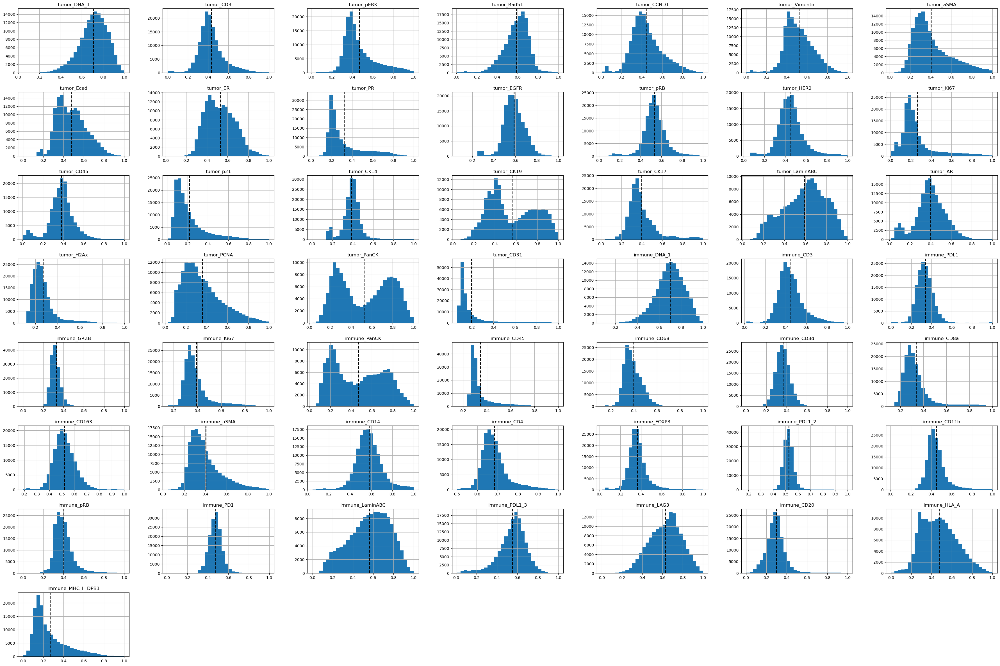

In [38]:
process_data.visualize_hists(tracked,plot_mean=True, exclude_list = ["core"]+["{}_{}".format(x,y) for x in ['tumor', 'immune'] for y in ['CellID','cluster']])



### Convert to cudf, write to csv, delete from memory

In [39]:
tracked = cudf.from_pandas(tracked) #writes chunks efficiently.
tracked.to_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked.csv", index=False)


In [40]:
#tracked = cudf.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked.csv")
tracked.head()

,tumor_CellID,core,tumor_DNA_1,tumor_CD3,tumor_pERK,tumor_Rad51,tumor_CCND1,tumor_Vimentin,tumor_aSMA,tumor_Ecad,...,immune_CD11b,immune_pRB,immune_PD1,immune_LaminABC,immune_PDL1_3,immune_LAG3,immune_CD20,immune_HLA_A,immune_MHC_II_DPB1,immune_cluster
0,4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,...,0.330853,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8
1,16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,...,0.327798,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8
2,7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,...,0.304305,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8
3,23,A10,0.233838,0.017092,0.204227,0.243604,0.018824,0.078568,0.191108,0.144855,...,0.406588,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8
4,20,A10,0.656867,0.253500,0.474569,0.721957,0.459799,0.313952,0.386038,0.728411,...,0.336896,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22


### Cluster the combined panels!

In [41]:
""" CLUSTER THE TRACKED CELLS """

out_csv_path = "/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked.csv"
tracked = grapheno_ce.cluster(out_csv_path, 
                  features = [x for x in tracked.columns.tolist() if x not in ['core']+['{}_{}'.format(x,y) for x in ['tumor','immune'] for y in ['cluster','CellID']]],
                  n_neighbors=100,
                  distributed_knn = True,
                  distributed_graphs = False,
                  index_col = None,
                  new_column_name = 'combined_cluster',
                  overwrite = False,
                  min_size=1500) #the data size is ~1M cells. The rare cell subtype is approx 1% of all cells.

Computing and caching 100NN edgelist: all_tracked_100NN_edgelist.parquet
100NN edgelist computed and cached in 2.25 seconds...
Computing and caching jaccard edgelist: all_tracked_100NN_edgelist_jaccard.parquet
Jaccard graph computed, cached, and reloaded in 2.54 seconds...
Computing Leiden clustering over Jaccard graph...
Leiden clustering completed in 0.58 seconds...
Clusters detected: 44
Clusters modularity: 0.9170778393745422
Writing output dataframe: /home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked_100NN_leiden.parquet
Grapheno completed in 6.16 seconds!


In [49]:
tracked = tracked.to_pandas()
tracked.head()

,tumor_CellID,core,tumor_DNA_1,tumor_CD3,tumor_pERK,tumor_Rad51,tumor_CCND1,tumor_Vimentin,tumor_aSMA,tumor_Ecad,...,immune_pRB,immune_PD1,immune_LaminABC,immune_PDL1_3,immune_LAG3,immune_CD20,immune_HLA_A,immune_MHC_II_DPB1,immune_cluster,combined_cluster
0,4,A10,0.592650,0.092551,0.414545,0.561117,0.053459,0.118555,0.238695,0.184648,...,0.196195,0.292563,0.283497,0.224175,0.401639,0.165090,0.159446,0.164194,23,51
1,16,A10,0.657725,0.201770,0.444738,0.710829,0.014496,0.072505,0.233676,0.122799,...,0.223394,0.339774,0.154995,0.098833,0.298011,0.151632,0.140933,0.115864,23,51
2,7,A10,0.448657,0.023427,0.203787,0.254151,0.008126,0.064720,0.222379,0.124199,...,0.166835,0.274284,0.191458,0.296811,0.400251,0.158828,0.148056,0.134502,9,40
3,23,A10,0.233405,0.016209,0.200840,0.241579,0.017341,0.079075,0.221544,0.128147,...,0.209314,0.332197,0.161391,0.134831,0.331173,0.118721,0.126146,0.099061,23,40
4,20,A10,0.656559,0.239051,0.463071,0.719800,0.420058,0.315620,0.408768,0.641004,...,0.211301,0.335880,0.394009,0.364978,0.516913,0.201798,0.201417,0.155930,29,37


# UMAP VISUALIZATIONS
### Skip for now, unless you want to visualize clusters before assigning untracked cells.
Use umap py38 fast for UMAP visualizations (takes less than 10 seconds for ~1M cells, 160 markers) or UMAP env py 3.8.13

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
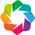

In [1]:
import numpy as np 
import pandas as pd
from scipy.spatial.distance import cdist
import process_data

import cuml
import cudf

import time

from scipy import stats

from holoviews.operation.datashader import datashade
import holoviews as hv
from holoviews import opts
from colorcet import fire, glasbey_hv
import datashader as ds
hv.extension('bokeh') # specify which library for plotting, e.g. 'bokeh' or 'matplotlib'
from holoviews.operation.datashader import dynspread

dynspread.max_px=2
dynspread.threshold=1.0

import seaborn as sns

In [2]:
def pad_with_zero(entry):
    # Extract the letter and numeric parts
    letter = entry[0]
    number = entry[1:]
    
    # If the number part has only one digit, pad with 0
    if len(number) == 1:
        number = '0' + number
        
    return letter + number

### Load the METADATA!

In [3]:
meta1 = pd.read_csv('/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/HTAN_meta1.csv', delimiter=',', usecols=[0,1,2])
meta2 = pd.read_csv('/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/HTAN_meta2.csv', delimiter=',')
meta2 = meta2.replace({r'\s+$': '', r'^\s+': ''}, regex=True).replace(r'\n',  '', regex=True)
meta2 = meta2.replace({r'\s+$': '', r'^\s+': ''}, regex=True).replace(r'  ',  ' ', regex=True)
meta2 = meta2.replace(r'^\s*$', np.nan, regex=True)
meta2.columns = meta2.columns.str.replace('\n', '')
meta2.columns = meta2.columns.str.replace('  ', ' ')
meta2.set_index('HTAN Participant ID', inplace=True)
meta1.set_index('HTAN Participant ID', inplace=True)
metadata = pd.merge(meta2, meta1, on = ['HTAN Participant ID'], how = 'outer').reset_index()
metadata.rename(columns={'Array Position': 'core', 'Subtybe': 'Subtype'}, inplace=True)

metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']

metadata.head()

,HTAN Participant ID,Age,Sex,Anat. Site,Pathology,Grade,Clinic stage (TNM),Subtype,core,Pantomics Ref. No.
0,HTA14_25,43,F,Breast,Invasive ductal carcinoma,I,T2N2M0,Luminal A,C04,F09-1290
1,HTA14_25,43,F,Breast,Invasive ductal carcinoma,I,T2N2M0,Luminal A,G10,F09-1290
2,HTA14_34,55,F,Breast,Invasive ductal carcinoma,II,T2N2M0,Luminal A,D07,F09-1814
3,HTA14_34,55,F,Breast,Invasive ductal carcinoma,II,T2N2M0,Luminal A,G02,F09-1814
4,HTA14_5,43,F,Breast,Invasive ductal carcinoma,II,T2N0M0,Luminal A,A05,F18-0992


### CLUSTER THE TRACKED CELLS ONLY

In [4]:
tracked = pd.read_parquet("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked_100NN_leiden.parquet")
tracked.head()

,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,GRZB,HLA_A,LAG3,MHC_II_DPB1,PD1,PDL1,PDL1_2,PDL1_3,core,cluster
0,0.245999,0.026244,0.069372,0.153474,0.008608,0.011143,0.014784,0.041954,0.054805,0.024923,...,0.240309,0.014023,0.086099,0.036250,0.177065,0.028235,0.314743,0.095853,A10,25
1,0.313046,0.066128,0.082068,0.308851,0.001626,0.006021,0.014205,0.025205,0.043282,0.011569,...,0.205814,0.011650,0.050331,0.022749,0.213338,0.027303,0.282306,0.035260,A10,25
2,0.137889,0.006080,0.017753,0.028936,0.000563,0.005250,0.012963,0.025550,0.041327,0.010842,...,0.177028,0.012540,0.085523,0.027686,0.163660,0.018262,0.272810,0.137646,A10,25
3,0.043669,0.004168,0.017339,0.026562,0.002107,0.006692,0.012874,0.026532,0.041624,0.012342,...,0.228601,0.009888,0.060312,0.018566,0.207349,0.036957,0.295743,0.051310,A10,25
4,0.311721,0.082461,0.090740,0.321737,0.140479,0.048698,0.049019,0.338802,0.177976,0.113538,...,0.266972,0.020169,0.146034,0.033776,0.210252,0.041084,0.374695,0.182144,A10,10


In [5]:
tracked['core'].unique() #need to rename these to match the metadata.

array(['A10', 'A5', 'A6', 'A8', 'B10', 'B1', 'B3', 'B4', 'B6', 'B7', 'B9',
       'C10', 'C1', 'C4', 'D11', 'D2', 'D8', 'E10', 'E3', 'E5', 'E6',
       'E7', 'E8', 'E9', 'F11', 'F1', 'F2', 'F7', 'G11', 'G1', 'G3', 'G6',
       'G7', 'G9', 'H10', 'H1', 'H2', 'H3', 'H4', 'H6', 'H7', 'H8', 'H9'],
      dtype=object)

In [6]:
#read the CSV
""" pad_with_zero IS DEFINED BELOW (do a control-find) !!! """
tracked['core'] = tracked['core'].apply(pad_with_zero)
tracked.drop_duplicates(inplace=True) #same as below.
#tumor_all_recombined = tumor_all_recombined[~tumor_all_recombined.index.duplicated(keep='first')]#.drop_duplicates(inplace=True) #404104
print(tracked.shape)
print(tracked['core'].unique())
tracked.head()


(179473, 44)
['A10' 'A05' 'A06' 'A08' 'B10' 'B01' 'B03' 'B04' 'B06' 'B07' 'B09' 'C10'
 'C01' 'C04' 'D11' 'D02' 'D08' 'E10' 'E03' 'E05' 'E06' 'E07' 'E08' 'E09'
 'F11' 'F01' 'F02' 'F07' 'G11' 'G01' 'G03' 'G06' 'G07' 'G09' 'H10' 'H01'
 'H02' 'H03' 'H04' 'H06' 'H07' 'H08' 'H09']


,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,GRZB,HLA_A,LAG3,MHC_II_DPB1,PD1,PDL1,PDL1_2,PDL1_3,core,cluster
0,0.245999,0.026244,0.069372,0.153474,0.008608,0.011143,0.014784,0.041954,0.054805,0.024923,...,0.240309,0.014023,0.086099,0.036250,0.177065,0.028235,0.314743,0.095853,A10,25
1,0.313046,0.066128,0.082068,0.308851,0.001626,0.006021,0.014205,0.025205,0.043282,0.011569,...,0.205814,0.011650,0.050331,0.022749,0.213338,0.027303,0.282306,0.035260,A10,25
2,0.137889,0.006080,0.017753,0.028936,0.000563,0.005250,0.012963,0.025550,0.041327,0.010842,...,0.177028,0.012540,0.085523,0.027686,0.163660,0.018262,0.272810,0.137646,A10,25
3,0.043669,0.004168,0.017339,0.026562,0.002107,0.006692,0.012874,0.026532,0.041624,0.012342,...,0.228601,0.009888,0.060312,0.018566,0.207349,0.036957,0.295743,0.051310,A10,25
4,0.311721,0.082461,0.090740,0.321737,0.140479,0.048698,0.049019,0.338802,0.177976,0.113538,...,0.266972,0.020169,0.146034,0.033776,0.210252,0.041084,0.374695,0.182144,A10,10


In [7]:
metadata.columns

Index(['HTAN Participant ID', 'Age', 'Sex', 'Anat. Site', 'Pathology', 'Grade',
       'Clinic stage (TNM)', 'Subtype', 'core', 'Pantomics Ref. No.'],
      dtype='object')

In [ ]:
"""
RUN UMAP
"""
import time
np.random.seed(0)
print("here")
start = time.time()
umap = cuml.UMAP(n_neighbors=20)
drop_list = ['cross_cluster','cluster','core', 'CellID', 'combined_cluster'] + ["{}_{}".format(x,y) for x in ['tumor','immune'] for y in ['CellID', 'cluster']] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x in tracked.columns.to_list()]
print("fitting...")
umap_embed = umap.fit_transform(tracked.drop(drop_list,axis=1))#.rename(columns={0:'UMAP1',1:'UMAP2'})
end = time.time()
print("Total UMAP training time = {}".format(end-start))

In [33]:
 
#### SET COLOR BY SCHEME ####
color_by = "Pathology"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
if color_by in tracked.reset_index().columns.tolist():
    umap_coords = pd.concat([umap_coords,tracked.reset_index()[keep_inds][color_by]], axis=1)
else:
    print("Adding metadata...")
    umap_coords[color_by] = np.stack([metadata.loc[metadata['core']==x][color_by].values for x in tracked.reset_index()[keep_inds]['core']])
    print("Complete.")
#umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)

#########################################

#############################
#metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']
good_name_list = ["cluster", "core", "cross_cluster"] + metadata_list
#assert color_by in good_name_list, "'{}' must be one of the following: {}".format(color_by, good_name_list)

if color_by in good_name_list:
    if color_by == "cluster":
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cluster.unique()))]
        cluster_dta = umap_coords.groupby('cluster').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
    elif color_by == "cross_cluster":
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cross_cluster.unique()))]
        cluster_dta = umap_coords.groupby('cross_cluster').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
        
    elif color_by == "core":
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.core.unique()))]
        cluster_dta = umap_coords.groupby('core').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
    elif color_by in metadata_list:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(metadata[color_by].unique()))]
        #add the correct data column
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
    umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                           aggregator=ds.count_cat(color_by),
                           color_key=color_key).opts(padding=0.1,
                                                     xaxis=None,
                                                     yaxis=None,
                                                     width=700,
                                                     height=700,
                                                     legend_position='right'))

else:
    if color_by in tracked.columns.tolist():
        #probably continuous. 
        umap_coords = pd.concat([umap_coords,tracked.reset_index()[keep_inds]['cluster']], axis=1)
        cluster_dta = umap_coords.groupby('cluster').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
        
        umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=10),
                       aggregator=ds.mean(color_by),
                       cmap = fire).opts(padding=0.1,
                             xaxis=None,
                             yaxis=None,
                             width=700,
                             height=700))
    

umap_ds*labels

Adding metadata...
Complete.


:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

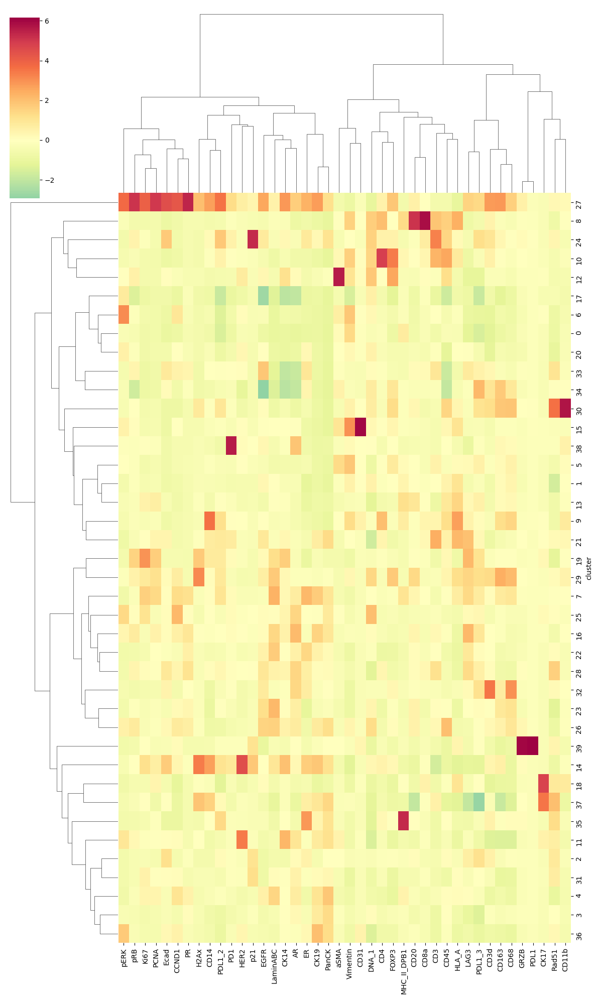

In [19]:
""" MAKE MARKER HEATMAP PLOT """
import matplotlib.pyplot as plt
drop_cols = ['core', 'cross_cluster','cluster', 'CellID'] + metadata_list
drop_cols = [x for x in drop_list if x in tracked.columns.to_list()]
drop_cols = [x for x in drop_cols if x != color_by]
#good_col_names = pd.read_csv('/home/groups/CEDAR/eddyc/projects/cyc_IF/UMAP/data/Normalized Mean Intensities_processed_robust_CE.csv', index_col=0, nrows=0).columns.tolist()[:-1] #exclude 'Sample'
g = sns.clustermap(tracked.drop(drop_cols, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tracked_{}_heatmap.pdf".format(color_by), format='pdf')

## Cluster by tumor data by one sample only

In [14]:
tumor_all.head()

,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,p21,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31
CellID,core,,,,,,,,,,,,,,,,,,,,,
1,A10,0.050304,0.011081,0.204755,0.159489,0.028106,0.076453,0.241154,0.311761,0.573052,0.301723,...,0.211441,0.275387,0.937623,0.213455,0.425983,0.266899,0.137517,0.142475,0.953016,0.049949
2,A10,0.842577,0.011567,0.234937,0.122394,0.076048,0.066792,0.290444,0.122677,0.428962,0.102360,...,0.017079,0.141430,0.311687,0.304810,0.162493,0.059154,0.104956,0.083660,0.135535,0.040134
3,A10,0.644994,0.052345,0.282097,0.378648,0.060456,0.205188,0.544174,0.148191,0.425057,0.103097,...,0.053123,0.140398,0.324434,0.190729,0.195010,0.083551,0.107882,0.095081,0.214846,0.044834
4,A10,0.780535,0.098520,0.398715,0.583196,0.055119,0.132422,0.287448,0.185785,0.438789,0.151933,...,0.080068,0.150069,0.551883,0.177708,0.196521,0.079939,0.102530,0.080974,0.354396,0.042238
5,A10,0.637130,0.055310,0.330163,0.496080,0.040893,0.082275,0.291563,0.150443,0.393538,0.100474,...,0.056066,0.140404,0.406104,0.172687,0.189027,0.061721,0.101094,0.083406,0.647060,0.038385


In [6]:
"""
RUN UMAP
"""
np.random.seed(0)

start = time.time()
umap = cuml.UMAP(n_neighbors=50)
umap_embed = umap.fit_transform(tumor_all.loc[tumor_all.index.get_level_values('core').isin(['A10'])].reset_index().drop(["core","CellID"],axis=1))
end = time.time()
print("Total UMAP training time = {}".format(end-start))

Total UMAP training time = 3.9463768005371094


In [7]:

#### SET COLOR BY SCHEME ####
color_by = "core"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
#umap_coords = pd.concat([umap_coords,tracked[keep_inds][color_by]], axis=1)
if color_by in tumor_all_recombined.reset_index().columns.tolist():
    umap_coords = pd.concat([umap_coords,tumor_all.loc[tumor_all.index.get_level_values('core').isin(['A10'])].reset_index()[keep_inds][color_by]], axis=1)
else:
    print("Adding metadata...")
    umap_coords[color_by] = np.stack([metadata.loc[metadata['core']==x][color_by].values for x in tumor_all.loc[tumor_all.index.get_level_values('core').isin(['A10'])].reset_index()[keep_inds]['core']])
    print("Complete.")
#umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)

#########################################

#############################
#metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']
good_name_list = ["cluster", "core", "cross_cluster"] + metadata_list
assert color_by in good_name_list, "'{}' must be one of the following: {}".format(color_by, good_name_list)

if color_by == "cluster":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cluster.unique()))]
    cluster_dta = umap_coords.groupby('cluster').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

elif color_by == "cross_cluster":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cross_cluster.unique()))]
    cluster_dta = umap_coords.groupby('cross_cluster').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
elif color_by == "core":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.core.unique()))]
    cluster_dta = umap_coords.groupby('core').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

elif color_by in metadata_list:
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(metadata[color_by].unique()))]
    #add the correct data column
    cluster_dta = umap_coords.groupby(color_by).mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')


    
umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                       aggregator=ds.count_cat(color_by),
                       color_key=color_key).opts(padding=0.1,
                                                 xaxis=None,
                                                 yaxis=None,
                                                 width=700,
                                                 height=700,
                                                 legend_position='right'))

umap_ds*labels

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

## Cluster all tumor data only

In [8]:
print(tumor_all.shape)
tumor_all.head()

(413073, 25)


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,p21,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31
CellID,core,,,,,,,,,,,,,,,,,,,,,
1,A10,0.050304,0.011081,0.204755,0.159489,0.028106,0.076453,0.241154,0.311761,0.573052,0.301723,...,0.211441,0.275387,0.937623,0.213455,0.425983,0.266899,0.137517,0.142475,0.953016,0.049949
2,A10,0.842577,0.011567,0.234937,0.122394,0.076048,0.066792,0.290444,0.122677,0.428962,0.102360,...,0.017079,0.141430,0.311687,0.304810,0.162493,0.059154,0.104956,0.083660,0.135535,0.040134
3,A10,0.644994,0.052345,0.282097,0.378648,0.060456,0.205188,0.544174,0.148191,0.425057,0.103097,...,0.053123,0.140398,0.324434,0.190729,0.195010,0.083551,0.107882,0.095081,0.214846,0.044834
4,A10,0.780535,0.098520,0.398715,0.583196,0.055119,0.132422,0.287448,0.185785,0.438789,0.151933,...,0.080068,0.150069,0.551883,0.177708,0.196521,0.079939,0.102530,0.080974,0.354396,0.042238
5,A10,0.637130,0.055310,0.330163,0.496080,0.040893,0.082275,0.291563,0.150443,0.393538,0.100474,...,0.056066,0.140404,0.406104,0.172687,0.189027,0.061721,0.101094,0.083406,0.647060,0.038385


In [12]:
"""
RUN UMAP
"""
np.random.seed(0)

start = time.time()
umap = cuml.UMAP(n_neighbors=50)
umap_embed = umap.fit_transform(tumor_all.reset_index().drop(["core","CellID"],axis=1))
end = time.time()
print("Total UMAP training time = {}".format(end-start))

Total UMAP training time = 6.273425340652466


In [13]:

#### SET COLOR BY SCHEME ####
color_by = "core"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
#umap_coords = pd.concat([umap_coords,tracked[keep_inds][color_by]], axis=1)
if color_by in tumor_all_recombined.reset_index().columns.tolist():
    umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)
else:
    print("Adding metadata...")
    umap_coords[color_by] = np.stack([metadata.loc[metadata['core']==x][color_by].values for x in tumor_all.reset_index()[keep_inds]['core']])
    print("Complete.")
#umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)

#########################################

#############################
#metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']
good_name_list = ["cluster", "core", "cross_cluster"] + metadata_list
assert color_by in good_name_list, "'{}' must be one of the following: {}".format(color_by, good_name_list)

if color_by == "cluster":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cluster.unique()))]
    cluster_dta = umap_coords.groupby('cluster').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

elif color_by == "cross_cluster":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cross_cluster.unique()))]
    cluster_dta = umap_coords.groupby('cross_cluster').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
elif color_by == "core":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.core.unique()))]
    cluster_dta = umap_coords.groupby('core').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

elif color_by in metadata_list:
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(metadata[color_by].unique()))]
    #add the correct data column
    cluster_dta = umap_coords.groupby(color_by).mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

    
umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                       aggregator=ds.count_cat(color_by),
                       color_key=color_key).opts(padding=0.1,
                                                 xaxis=None,
                                                 yaxis=None,
                                                 width=700,
                                                 height=700,
                                                 legend_position='right'))

umap_ds*labels

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

## Cluster by tracked data

### Cluster only one sample of tracked data!

In [ ]:
"""
RUN UMAP
"""
np.random.seed(0)

use_groups = ['A10', 'A5','A6']

start = time.time()
umap = cuml.UMAP(n_neighbors=20)
drop_list = ['cluster','core'] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x in tracked.columns.to_list()]
umap_embed = umap.fit_transform(tracked.loc[tracked.core.isin(use_groups)].drop(drop_list,axis=1))#.rename(columns={0:'UMAP1',1:'UMAP2'})
end = time.time()
print("Total UMAP training time = {}".format(end-start))


In [48]:

#### SET COLOR BY SCHEME ####
color_by = "core"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
#umap_coords = pd.concat([umap_coords,tracked[keep_inds][color_by]], axis=1)
umap_coords = pd.concat([umap_coords,tracked.loc[tracked.core.isin(use_groups)][keep_inds][color_by]], axis=1)

#########################################

#############################

assert color_by in ["cluster", "core"], "'{}' must be one of the following: {}".format(color_by, ["cluster", "core"])

if color_by == "cluster":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cluster.unique()))]
    cluster_dta = umap_coords.groupby('cluster').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
elif color_by == "core":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.core.unique()))]
    cluster_dta = umap_coords.groupby('core').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

    
umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                       aggregator=ds.count_cat(color_by),
                       color_key=color_key).opts(padding=0.1,
                                                 xaxis=None,
                                                 yaxis=None,
                                                 width=700,
                                                 height=700,
                                                 legend_position='right'))

umap_ds*labels

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

### Cluster ALL tracked data

In [6]:
"""
RUN UMAP
"""
np.random.seed(0)

start = time.time()
umap = cuml.UMAP(n_neighbors=20)
drop_list = ['cluster','core'] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x in tracked.columns.to_list()]
umap_embed = umap.fit_transform(tracked.drop(drop_list,axis=1))#.rename(columns={0:'UMAP1',1:'UMAP2'})
end = time.time()
print("Total UMAP training time = {}".format(end-start))

Total UMAP training time = 4.941816806793213


In [7]:

#### SET COLOR BY SCHEME ####
color_by = "core"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
umap_coords = pd.concat([umap_coords,tracked[keep_inds][color_by]], axis=1)
#umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)

#########################################

#############################

assert color_by in ["cluster", "core"], "'{}' must be one of the following: {}".format(color_by, ["cluster", "core"])

if color_by == "cluster":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.cluster.unique()))]
    cluster_dta = umap_coords.groupby('cluster').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
elif color_by == "core":
    color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords.core.unique()))]
    cluster_dta = umap_coords.groupby('core').mean()
    labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')

    
umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                       aggregator=ds.count_cat(color_by),
                       color_key=color_key).opts(padding=0.1,
                                                 xaxis=None,
                                                 yaxis=None,
                                                 width=700,
                                                 height=700,
                                                 legend_position='right'))

umap_ds*labels

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

In [ ]:
import scanpy as sc
import anndata
import numpy as np 
import pandas as pd
from scipy.spatial.distance import cdist
import process_data

In [17]:
tracked = pd.read_parquet("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked_100NN_leiden.parquet")
tracked.head()

,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,GRZB,HLA_A,LAG3,MHC_II_DPB1,PD1,PDL1,PDL1_2,PDL1_3,core,cluster
0,0.227020,0.077710,0.076263,0.629902,0.097197,0.046319,0.031481,0.202654,0.293675,0.078616,...,0.192016,0.013040,0.129832,0.042375,0.368602,0.042727,0.202556,0.126336,A10,28
1,0.137424,0.052943,0.052955,0.493430,0.043344,0.022036,0.032409,0.214178,0.167414,0.046720,...,0.245986,0.021486,0.246519,0.037473,0.398227,0.072650,0.245846,0.236338,A10,28
2,0.175443,0.092252,0.061906,0.455472,0.105946,0.031963,0.018070,0.469210,0.414825,0.114444,...,0.245057,0.026032,0.281410,0.048865,0.442807,0.054849,0.308827,0.281663,A10,28
3,0.261781,0.074466,0.053831,0.645538,0.089569,0.046720,0.048043,0.289077,0.266804,0.108404,...,0.234099,0.021910,0.275429,0.038967,0.443538,0.066613,0.382762,0.249504,A10,28
4,0.254146,0.098483,0.068465,0.479691,0.092149,0.028645,0.026169,0.708107,0.566548,0.152849,...,0.162488,0.022042,0.306202,0.038137,0.466653,0.057726,0.309908,0.277467,A10,28


Next, we want to take our cluster IDs from the leiden clustering, and for the cells within modalities that were not tracked, find the closest (most similar) cell that was tracked in order to assign the same cell type. This assumes (perhaps incorrectly) that the tracked cells contained all the possible datatypes. An alternative approach would be to cluster each modality on its own, then assign a whole cluster of the untracked cells to whatever the majority of cells that were tracked.

# LABEL PROPAGATION: Assign Untracked cells using the tracked cells!
#### For the clusters, grab the cluster assignment label to the tumor_tracked and immune_tracked dataframes!

## Use cuML to do KNN search (use rapids-22.08 environment)
Doesn't yet seem possible, since the input has to be a single dataframe of examples x features, whereas we want to compute the NN from one dataframe to another.
We should just ry to use scipy. if it is too slow, switch to cudf and use something like this: https://stackoverflow.com/questions/62482609/find-nearest-index-in-one-dataframe-to-another

In [1]:
import pandas as pd 
import numpy as np
import cudf
from cuml.neighbors import KNeighborsClassifier as cuKNeighbors
import os

In [2]:
tracked = pd.read_parquet("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked_100NN_leiden.parquet")
tracked.head()

,tumor_CellID,core,tumor_DNA_1,tumor_CD3,tumor_pERK,tumor_Rad51,tumor_CCND1,tumor_Vimentin,tumor_aSMA,tumor_Ecad,...,immune_pRB,immune_PD1,immune_LaminABC,immune_PDL1_3,immune_LAG3,immune_CD20,immune_HLA_A,immune_MHC_II_DPB1,immune_cluster,combined_cluster
0,4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,...,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8,32
1,16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,...,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8,32
2,7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,...,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8,32
3,23,A10,0.233838,0.017092,0.204227,0.243604,0.018824,0.078568,0.191108,0.144855,...,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8,32
4,20,A10,0.656867,0.253500,0.474569,0.721957,0.459799,0.313952,0.386038,0.728411,...,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22,-1


**The following variables are defined above in the first section of the script. Go up there and run to define them in memory.**


In [3]:
tumor_all = pd.read_parquet("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/tumor_all_100NN_leiden.parquet")
tumor_all.set_index(["CellID", "core"], inplace=True)


In [4]:
print(tumor_all.shape)
tumor_all.head()

(320148, 26)


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,CK14,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31,cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
2,A10,0.702094,0.007812,0.236265,0.091435,0.076309,0.055020,0.212411,0.136626,0.322706,0.132862,...,0.137436,0.174025,0.322737,0.159832,0.062937,0.144708,0.089967,0.134004,0.072042,28
4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,0.334598,0.198072,...,0.146655,0.465341,0.182592,0.193314,0.081392,0.145067,0.086962,0.352842,0.075883,26
5,A10,0.344201,0.052292,0.348299,0.467727,0.033360,0.069676,0.213702,0.168325,0.280042,0.130388,...,0.136348,0.288020,0.177178,0.196459,0.041531,0.142353,0.090151,0.647520,0.068852,28
6,A10,0.625675,0.203558,0.531227,0.732149,0.338833,0.324283,0.357411,0.441596,0.483754,0.396127,...,0.173727,0.601213,0.278398,0.221522,0.100822,0.154062,0.083273,0.529567,0.079486,0
7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,0.279278,0.109393,...,0.130711,0.206550,0.305322,0.197596,0.063536,0.146040,0.089842,0.252978,0.088613,28


In [5]:
#For the untracked cells, we need to assign cell types. To do so, we will use whatever cell that was tracked and make it the same type!
tumor_all_untracked = tumor_all.loc[~tumor_all.index.isin(tracked.set_index(['tumor_CellID', 'core']).index)]
tumor_all_tracked = tumor_all.loc[tumor_all.index.isin(tracked.set_index(['tumor_CellID', 'core']).index)]
#need to add the labels, from tracked. They should be 1:1, even though their values are different because we applied normalization using two different datasets.
labs = tracked['combined_cluster']

In [6]:

# build a cudf Dataframe
t_tracked = cudf.from_pandas(tumor_all_tracked.reset_index().drop(['core','CellID','cluster'],axis=1)) # this should be tracked_assigned_df as a cudf.
t_untracked = cudf.from_pandas(tumor_all_untracked.reset_index().drop(['core','CellID','cluster'],axis=1)) # this should be tracked_assigned_df as a cudf.
# fit model
print("Fitting model")
model = cuKNeighbors(n_neighbors=10)
model.fit(t_tracked, labs)

print("predicting")
y_hat = model.predict(t_untracked)

print(y_hat.shape)

Fitting model
predicting
(173922,)


In [7]:
tumor_all_untracked['cross_cluster'] = y_hat.to_pandas().values.tolist()
print(tumor_all_untracked.shape)
tumor_all_untracked.head()

(173922, 27)


/tmp/ipykernel_23549/1849227636.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tumor_all_untracked['cross_cluster'] = y_hat.to_pandas().values.tolist()


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31,cluster,cross_cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
2,A10,0.702094,0.007812,0.236265,0.091435,0.076309,0.055020,0.212411,0.136626,0.322706,0.132862,...,0.174025,0.322737,0.159832,0.062937,0.144708,0.089967,0.134004,0.072042,28,-1
5,A10,0.344201,0.052292,0.348299,0.467727,0.033360,0.069676,0.213702,0.168325,0.280042,0.130388,...,0.288020,0.177178,0.196459,0.041531,0.142353,0.090151,0.647520,0.068852,28,32
6,A10,0.625675,0.203558,0.531227,0.732149,0.338833,0.324283,0.357411,0.441596,0.483754,0.396127,...,0.601213,0.278398,0.221522,0.100822,0.154062,0.083273,0.529567,0.079486,0,-1
8,A10,0.530335,0.148653,0.463098,0.677532,0.225259,0.216627,0.361255,0.453288,0.415243,0.313446,...,0.671978,0.223683,0.269435,0.142901,0.156772,0.116845,0.870776,0.076759,28,-1
9,A10,0.504602,0.018239,0.251868,0.201719,0.039489,0.069485,0.189092,0.142033,0.298639,0.118482,...,0.241286,0.177562,0.180966,0.066131,0.138232,0.088196,0.203614,0.071729,28,-1


In [8]:
tumor_all_tracked['cross_cluster'] = labs.values.tolist()
print(tumor_all_tracked.shape)
tumor_all_tracked.head()

(146226, 27)


/tmp/ipykernel_23549/302577713.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tumor_all_tracked['cross_cluster'] = labs.values.tolist()


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31,cluster,cross_cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,0.334598,0.198072,...,0.465341,0.182592,0.193314,0.081392,0.145067,0.086962,0.352842,0.075883,26,32
7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,0.279278,0.109393,...,0.206550,0.305322,0.197596,0.063536,0.146040,0.089842,0.252978,0.088613,28,32
14,A10,0.594528,0.215593,0.481559,0.658789,0.332083,0.262177,0.288223,0.670128,0.553140,0.576136,...,0.916534,0.319315,0.449917,0.326255,0.192685,0.120330,0.835164,0.075243,35,32
16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,0.288151,0.114750,...,0.239250,0.416439,0.186912,0.044907,0.135299,0.090726,0.267297,0.084585,26,32
17,A10,0.433807,0.076937,0.294204,0.507673,0.054237,0.064663,0.228663,0.153944,0.301053,0.128623,...,0.264448,0.157748,0.182524,0.084748,0.138365,0.092871,0.265403,0.084623,26,-1


In [9]:
# Recombine back into one dataframe.
tumor_all_recombined = pd.concat([tumor_all_tracked, tumor_all_untracked])
print(tumor_all_recombined.shape)
tumor_all_recombined.head()

(320148, 27)


,,DNA_1,CD3,pERK,Rad51,CCND1,Vimentin,aSMA,Ecad,ER,PR,...,CK19,CK17,LaminABC,AR,H2Ax,PCNA,PanCK,CD31,cluster,cross_cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,0.334598,0.198072,...,0.465341,0.182592,0.193314,0.081392,0.145067,0.086962,0.352842,0.075883,26,32
7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,0.279278,0.109393,...,0.206550,0.305322,0.197596,0.063536,0.146040,0.089842,0.252978,0.088613,28,32
14,A10,0.594528,0.215593,0.481559,0.658789,0.332083,0.262177,0.288223,0.670128,0.553140,0.576136,...,0.916534,0.319315,0.449917,0.326255,0.192685,0.120330,0.835164,0.075243,35,32
16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,0.288151,0.114750,...,0.239250,0.416439,0.186912,0.044907,0.135299,0.090726,0.267297,0.084585,26,32
17,A10,0.433807,0.076937,0.294204,0.507673,0.054237,0.064663,0.228663,0.153944,0.301053,0.128623,...,0.264448,0.157748,0.182524,0.084748,0.138365,0.092871,0.265403,0.084623,26,-1


In [10]:
# Write to csv
tumor_all_recombined.reset_index().to_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/tumor_all_labeled.csv", index=False)

### Do the same operations but for the immune panel dataset

In [11]:
immune_all = pd.read_parquet("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/immune_all_100NN_leiden.parquet")
immune_all.set_index(["CellID", "core"], inplace=True)


In [12]:
immune_all.head()

,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,CD11b,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1,cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
1,A10,0.544020,0.252290,0.219375,0.295454,0.272837,0.789114,0.261185,0.262720,0.298458,0.154739,...,0.327232,0.284653,0.392452,0.094943,0.073724,0.311875,0.127894,0.126329,0.094604,8
2,A10,0.183046,0.032823,0.073919,0.214338,0.181816,0.236250,0.238558,0.184833,0.164345,0.165826,...,0.274759,0.170761,0.315096,0.119838,0.093396,0.245875,0.132681,0.089903,0.096232,31
3,A10,0.788027,0.267474,0.209654,0.297414,0.287187,0.866691,0.265973,0.290002,0.346500,0.214197,...,0.320407,0.247616,0.382971,0.167592,0.163995,0.319567,0.168581,0.137484,0.125285,8
4,A10,0.629092,0.262302,0.227440,0.348929,0.281468,0.944540,0.277059,0.279014,0.363918,0.241736,...,0.321736,0.267292,0.398352,0.355512,0.330928,0.412296,0.226114,0.196833,0.142810,22
5,A10,0.621012,0.201938,0.197128,0.325948,0.234655,0.871979,0.257438,0.240239,0.304613,0.227531,...,0.330853,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8


In [13]:
#For the untracked cells, we need to assign cell types. To do so, we will use whatever cell that was tracked and make it the same type!
immune_all_untracked = immune_all.loc[~immune_all.index.isin(tracked.set_index(['immune_CellID', 'core']).index)]
immune_all_tracked = immune_all.loc[immune_all.index.isin(tracked.set_index(['immune_CellID', 'core']).index)]
#need to add the labels, from tracked. They should be 1:1, even though their values are different because we applied normalization using two different datasets.
labs = tracked['combined_cluster']
#compute the distances for each of the rows of untracked vs those of tracked. For each, whichev
print(immune_all_tracked.head())
print(labs.head())

                DNA_1       CD3      PDL1      GRZB      Ki67     PanCK  \
CellID core                                                               
5      A10   0.621012  0.201938  0.197128  0.325948  0.234655  0.871979   
8      A10   0.739879  0.236730  0.192846  0.283543  0.262590  0.808967   
10     A10   0.609260  0.144971  0.146035  0.246927  0.218772  0.682607   
18     A10   0.674189  0.258362  0.233410  0.311737  0.272357  0.883488   
23     A10   0.743390  0.309685  0.248586  0.357613  0.274704  0.888967   

                 CD45      CD68      CD3d      CD8a  ...     CD11b       pRB  \
CellID core                                          ...                       
5      A10   0.257438  0.240239  0.304613  0.227531  ...  0.330853  0.227520   
8      A10   0.265100  0.277802  0.340708  0.226174  ...  0.327798  0.259270   
10     A10   0.239321  0.230106  0.243922  0.185584  ...  0.304305  0.193292   
18     A10   0.284576  0.313486  0.369114  0.226730  ...  0.406588  0.2428

In [14]:

# build a cudf Dataframe
i_tracked = cudf.from_pandas(immune_all_tracked.reset_index().drop(['core','CellID','cluster'],axis=1)) # this should be tracked_assigned_df as a cudf.
i_untracked = cudf.from_pandas(immune_all_untracked.reset_index().drop(['core','CellID','cluster'],axis=1)) # this should be tracked_assigned_df as a cudf.
# fit model
print("Fitting model")
model = cuKNeighbors(n_neighbors=10)
model.fit(i_tracked, labs)

print("predicting")
y_hat = model.predict(i_untracked)

print(y_hat.shape)

Fitting model
predicting
(166880,)


In [15]:
immune_all_untracked['cross_cluster'] = y_hat.to_pandas().values.tolist()
print(immune_all_untracked.shape)
immune_all_untracked.head()

(166880, 27)


/tmp/ipykernel_23549/2771294157.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  immune_all_untracked['cross_cluster'] = y_hat.to_pandas().values.tolist()


,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1,cluster,cross_cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
1,A10,0.544020,0.252290,0.219375,0.295454,0.272837,0.789114,0.261185,0.262720,0.298458,0.154739,...,0.284653,0.392452,0.094943,0.073724,0.311875,0.127894,0.126329,0.094604,8,-1
2,A10,0.183046,0.032823,0.073919,0.214338,0.181816,0.236250,0.238558,0.184833,0.164345,0.165826,...,0.170761,0.315096,0.119838,0.093396,0.245875,0.132681,0.089903,0.096232,31,1
3,A10,0.788027,0.267474,0.209654,0.297414,0.287187,0.866691,0.265973,0.290002,0.346500,0.214197,...,0.247616,0.382971,0.167592,0.163995,0.319567,0.168581,0.137484,0.125285,8,-1
4,A10,0.629092,0.262302,0.227440,0.348929,0.281468,0.944540,0.277059,0.279014,0.363918,0.241736,...,0.267292,0.398352,0.355512,0.330928,0.412296,0.226114,0.196833,0.142810,22,-1
6,A10,0.664858,0.148805,0.157549,0.270433,0.186205,0.268872,0.229398,0.189693,0.156399,0.160893,...,0.196780,0.311530,0.116837,0.058837,0.251903,0.133135,0.075947,0.093433,31,32


In [16]:
immune_all_tracked['cross_cluster'] = labs.values.tolist()
print(immune_all_tracked.shape)
immune_all_tracked.head()

(146226, 27)


/tmp/ipykernel_23549/1948771826.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  immune_all_tracked['cross_cluster'] = labs.values.tolist()


,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1,cluster,cross_cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
5,A10,0.621012,0.201938,0.197128,0.325948,0.234655,0.871979,0.257438,0.240239,0.304613,0.227531,...,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8,32
8,A10,0.739879,0.236730,0.192846,0.283543,0.262590,0.808967,0.265100,0.277802,0.340708,0.226174,...,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8,32
10,A10,0.609260,0.144971,0.146035,0.246927,0.218772,0.682607,0.239321,0.230106,0.243922,0.185584,...,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8,32
18,A10,0.674189,0.258362,0.233410,0.311737,0.272357,0.883488,0.284576,0.313486,0.369114,0.226730,...,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8,32
23,A10,0.743390,0.309685,0.248586,0.357613,0.274704,0.888967,0.287881,0.294170,0.376023,0.283719,...,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22,-1


In [17]:
# Recombine back into one dataframe.
immune_all_recombined = pd.concat([immune_all_tracked, immune_all_untracked])
print(immune_all_recombined.shape)
immune_all_recombined.head()

(313106, 27)


,,DNA_1,CD3,PDL1,GRZB,Ki67,PanCK,CD45,CD68,CD3d,CD8a,...,pRB,PD1,LaminABC,PDL1_3,LAG3,CD20,HLA_A,MHC_II_DPB1,cluster,cross_cluster
CellID,core,,,,,,,,,,,,,,,,,,,,,
5,A10,0.621012,0.201938,0.197128,0.325948,0.234655,0.871979,0.257438,0.240239,0.304613,0.227531,...,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8,32
8,A10,0.739879,0.236730,0.192846,0.283543,0.262590,0.808967,0.265100,0.277802,0.340708,0.226174,...,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8,32
10,A10,0.609260,0.144971,0.146035,0.246927,0.218772,0.682607,0.239321,0.230106,0.243922,0.185584,...,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8,32
18,A10,0.674189,0.258362,0.233410,0.311737,0.272357,0.883488,0.284576,0.313486,0.369114,0.226730,...,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8,32
23,A10,0.743390,0.309685,0.248586,0.357613,0.274704,0.888967,0.287881,0.294170,0.376023,0.283719,...,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22,-1


In [18]:
# Write to csv
immune_all_recombined.reset_index().to_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/immune_all_labeled.csv", index=False)

# Cluster with assigned cell types - switch back to umap py38 fast environment


## Do the same sets of visualizations using the assigned cell types for each modality individually.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
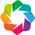

In [12]:
import numpy as np 
import pandas as pd
from scipy.spatial.distance import cdist
import process_data

import cuml

import time

from scipy import stats

from holoviews.operation.datashader import datashade
import holoviews as hv
from holoviews import opts
from colorcet import fire, glasbey_hv
import datashader as ds
hv.extension('bokeh') # specify which library for plotting, e.g. 'bokeh' or 'matplotlib'
from holoviews.operation.datashader import dynspread

dynspread.max_px=2
dynspread.threshold=1.0

import seaborn as sns

In [3]:
def pad_with_zero(entry):
    # Extract the letter and numeric parts
    letter = entry[0]
    number = entry[1:]
    
    # If the number part has only one digit, pad with 0
    if len(number) == 1:
        number = '0' + number
        
    return letter + number

In [6]:
#read the CSV
tumor_all_recombined = pd.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/tumor_all_labeled.csv", delimiter=",")
tumor_all_recombined['core'] = tumor_all_recombined['core'].apply(pad_with_zero)
tumor_all_recombined.set_index(["CellID", "core"], inplace=True)
tumor_all_recombined.sort_index(inplace=True)
tumor_all_recombined.drop_duplicates(inplace=True) #same as below.
#tumor_all_recombined = tumor_all_recombined[~tumor_all_recombined.index.duplicated(keep='first')]#.drop_duplicates(inplace=True) #404104
print(tumor_all_recombined.shape)
tumor_all_recombined.head()


(320148, 27)


DNA_1       CD3      pERK     Rad51     CCND1  Vimentin  \
CellID core                                                               
1      A05   0.507389  0.276298  0.440326  0.757667  0.254163  0.405068   
       B06   0.407818  0.341597  0.492504  0.805441  0.248131  0.598733   
       B09   0.447897  0.155052  0.265854  0.623273  0.066482  0.219072   
       B10   0.410478  0.359122  0.859911  0.650773  0.514873  0.406487   
       C10   0.357826  0.075045  0.425524  0.296051  0.087754  0.136307   

                 aSMA      Ecad        ER        PR  ...      CK19      CK17  \
CellID core                                          ...                       
1      A05   0.423277  0.656680  0.628720  0.325051  ...  0.576401  0.281578   
       B06   0.528322  0.801946  0.675781  0.257350  ...  0.486887  0.224518   
       B09   0.156266  0.152381  0.274712  0.128195  ...  0.267294  0.211072   
       B10   0.322678  0.251447  0.659749  0.294346  ...  0.263504  0.139004   
       C10   0.213838  0.182704  0.411750  0.203180  ...  0.400121  0.217718   

             LaminABC        AR      H2Ax      PCNA     PanCK      CD31  \
CellID core                                                               
1      A05   0.384728  0.361749  0.180080  0.231955  0.687214  0.120662   
       B06   0.283086  0.450588  0.205600  0.108129  0.618206  0.110348   
       B09   0.186401  0.072395  0.139317  0.161756  0.208182  0.086540   
       B10   0.137540  0.082648  0.145516  0.158837  0.160953  0.086239   
       C10   0.386361  0.079391  0.189310  0.184835  0.274603  0.084750   

             cluster  cross_cluster  
CellID core                          
1      A05         0              2  
       B06         0              3  
       B09        26              0  
       B10        37             11  
       C10        28             32  

[5 rows x 27 columns]

### Load the MetaDATA!

In [7]:
meta1 = pd.read_csv('/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/HTAN_meta1.csv', delimiter=',', usecols=[0,1,2])
meta2 = pd.read_csv('/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/HTAN_meta2.csv', delimiter=',')
meta2 = meta2.replace({r'\s+$': '', r'^\s+': ''}, regex=True).replace(r'\n',  '', regex=True)
meta2 = meta2.replace({r'\s+$': '', r'^\s+': ''}, regex=True).replace(r'  ',  ' ', regex=True)
meta2 = meta2.replace(r'^\s*$', np.nan, regex=True)
meta2.columns = meta2.columns.str.replace('\n', '')
meta2.columns = meta2.columns.str.replace('  ', ' ')
meta2.set_index('HTAN Participant ID', inplace=True)
meta1.set_index('HTAN Participant ID', inplace=True)
metadata = pd.merge(meta2, meta1, on = ['HTAN Participant ID'], how = 'outer').reset_index()
metadata.rename(columns={'Array Position': 'core', 'Subtybe': 'Subtype'}, inplace=True)
metadata.head()

,HTAN Participant ID,Age,Sex,Anat. Site,Pathology,Grade,Clinic stage (TNM),Subtype,core,Pantomics Ref. No.
0,HTA14_25,43,F,Breast,Invasive ductal carcinoma,I,T2N2M0,Luminal A,C04,F09-1290
1,HTA14_25,43,F,Breast,Invasive ductal carcinoma,I,T2N2M0,Luminal A,G10,F09-1290
2,HTA14_34,55,F,Breast,Invasive ductal carcinoma,II,T2N2M0,Luminal A,D07,F09-1814
3,HTA14_34,55,F,Breast,Invasive ductal carcinoma,II,T2N2M0,Luminal A,G02,F09-1814
4,HTA14_5,43,F,Breast,Invasive ductal carcinoma,II,T2N0M0,Luminal A,A05,F18-0992


### Insert the relevant metadata

In [8]:
"""
RUN UMAP
"""
import time
np.random.seed(0)

start = time.time()
umap = cuml.UMAP(n_neighbors=20)
drop_list = ['cross_cluster','cluster','core', 'CellID'] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x in tumor_all_recombined.columns.to_list()]
umap_embed = umap.fit_transform(tumor_all_recombined.drop(drop_list,axis=1))#.rename(columns={0:'UMAP1',1:'UMAP2'})
end = time.time()
print("Total UMAP training time = {}".format(end-start))

Total UMAP training time = 30.701590538024902


#### WARNING: TIME CONSUMING!

In [14]:
tumor_all_recombined.head()

DNA_1       CD3      pERK     Rad51     CCND1  Vimentin  \
CellID core                                                               
1      A05   0.507389  0.276298  0.440326  0.757667  0.254163  0.405068   
       B06   0.407818  0.341597  0.492504  0.805441  0.248131  0.598733   
       B09   0.447897  0.155052  0.265854  0.623273  0.066482  0.219072   
       B10   0.410478  0.359122  0.859911  0.650773  0.514873  0.406487   
       C10   0.357826  0.075045  0.425524  0.296051  0.087754  0.136307   

                 aSMA      Ecad        ER        PR  ...      CK19      CK17  \
CellID core                                          ...                       
1      A05   0.423277  0.656680  0.628720  0.325051  ...  0.576401  0.281578   
       B06   0.528322  0.801946  0.675781  0.257350  ...  0.486887  0.224518   
       B09   0.156266  0.152381  0.274712  0.128195  ...  0.267294  0.211072   
       B10   0.322678  0.251447  0.659749  0.294346  ...  0.263504  0.139004   
       C10   0.213838  0.182704  0.411750  0.203180  ...  0.400121  0.217718   

             LaminABC        AR      H2Ax      PCNA     PanCK      CD31  \
CellID core                                                               
1      A05   0.384728  0.361749  0.180080  0.231955  0.687214  0.120662   
       B06   0.283086  0.450588  0.205600  0.108129  0.618206  0.110348   
       B09   0.186401  0.072395  0.139317  0.161756  0.208182  0.086540   
       B10   0.137540  0.082648  0.145516  0.158837  0.160953  0.086239   
       C10   0.386361  0.079391  0.189310  0.184835  0.274603  0.084750   

             cluster  cross_cluster  
CellID core                          
1      A05         0              2  
       B06         0              3  
       B09        26              0  
       B10        37             11  
       C10        28             32  

[5 rows x 27 columns]

In [16]:
 
#### SET COLOR BY SCHEME ####
color_by = "CD3"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
if color_by in tumor_all_recombined.reset_index().columns.tolist():
    umap_coords = pd.concat([umap_coords,tumor_all_recombined.reset_index()[keep_inds][color_by]], axis=1)
else:
    print("Adding metadata...")
    umap_coords[color_by] = metadata.set_index('core').loc[tumor_all_recombined.reset_index()['core']][color_by].values
    print("Complete.")
#umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)

#########################################

#############################
metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']
good_name_list = ["cluster", "core", "cross_cluster"] + metadata_list

if color_by in good_name_list:
    assert color_by in good_name_list, "'{}' must be one of the following: {}".format(color_by, good_name_list)
    
    if color_by in ['cluster', 'cross_cluster', 'core']:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords['{}'.format(color_by)].unique()))]
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
    elif color_by in metadata_list:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(metadata[color_by].unique()))]
        #add the correct data column
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
        
    umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                           aggregator=ds.count_cat(color_by),
                           color_key=color_key).opts(padding=0.1,
                                                     xaxis=None,
                                                     yaxis=None,
                                                     width=700,
                                                     height=700,
                                                     legend_position='right'))

else:
    if color_by in tumor_all_recombined.columns.tolist():
        #probably continuous. 
        umap_coords = pd.concat([umap_coords,tumor_all_recombined.reset_index()[keep_inds]['cluster']], axis=1)
        cluster_dta = umap_coords.groupby('cluster').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
        
        umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=10),
                       aggregator=ds.mean(color_by),
                       cmap = fire).opts(padding=0.1,
                             xaxis=None,
                             yaxis=None,
                             width=700,
                             height=700))

umap_ds*labels

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

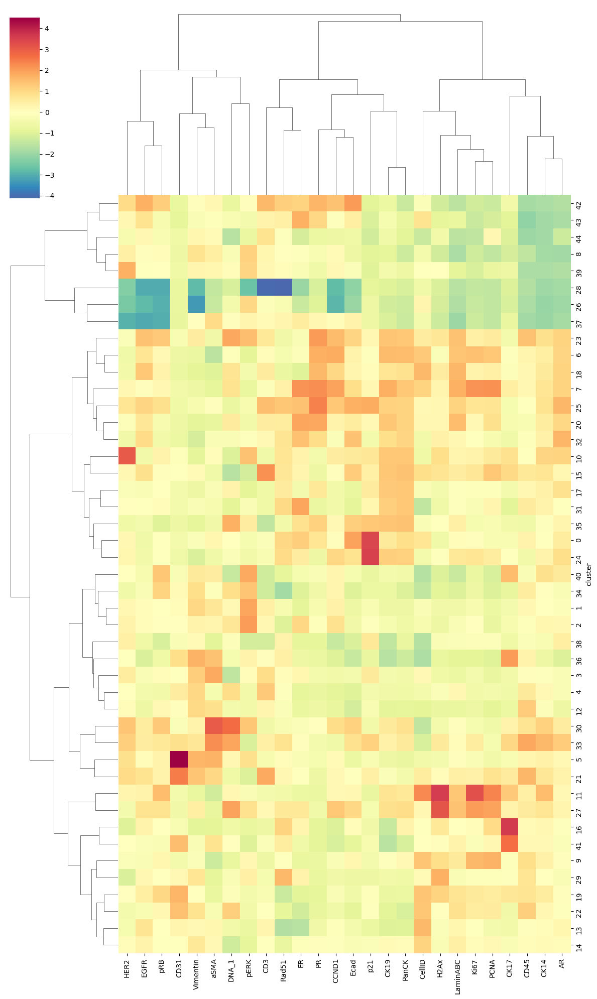

In [28]:
""" MAKE MARKER HEATMAP PLOT """
"""
To access the reordered row indices, use: clustergrid.dendrogram_row.reordered_ind
Column indices, use: clustergrid.dendrogram_col.reordered_ind
"""
color_by = "cluster"

import matplotlib.pyplot as plt
metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']

drop_cols = ['core', 'cross_cluster','cluster', 'CellID'] + metadata_list
drop_cols = [x for x in drop_cols if x != color_by]
drop_cols = [x for x in drop_cols if x in tumor_all_recombined.columns.to_list()]

#good_col_names = pd.read_csv('/home/groups/CEDAR/eddyc/projects/cyc_IF/UMAP/data/Normalized Mean Intensities_processed_robust_CE.csv', index_col=0, nrows=0).columns.tolist()[:-1] #exclude 'Sample'
g = sns.clustermap(tumor_all_recombined.reset_index().drop(drop_cols, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tumor_all_{}_heatmap.pdf".format(color_by), format='pdf')

In [30]:
from scipy.cluster.hierarchy import fcluster

KK = g.dendrogram_row.linkage
"""
A (n-1) by 4 matrix Z is returned. At the i-th iteration, clusters with indices Z[i, 0] and Z[i, 1] are combined to form cluster n+i. 
A cluster with an index less than n corresponds to one of the n original observations. The distance between clusters Z[i, 0] and Z[i, 1] 
is given by Z[i, 2]. The fourth value Z[i, 3] represents the number of original observations in the newly formed cluster.
"""

MAX_CLUSTERS = 24
clust = fcluster(KK, MAX_CLUSTERS, criterion='maxclust')


tumor_assignments = np.concatenate([np.expand_dims(np.array(list(range(np.max(tumor_all_recombined['cluster'])+1))),axis=-1), np.expand_dims(clust,axis=-1)], axis=-1)
tumor_assignments = {x:int(y) for [x,y] in tumor_assignments}

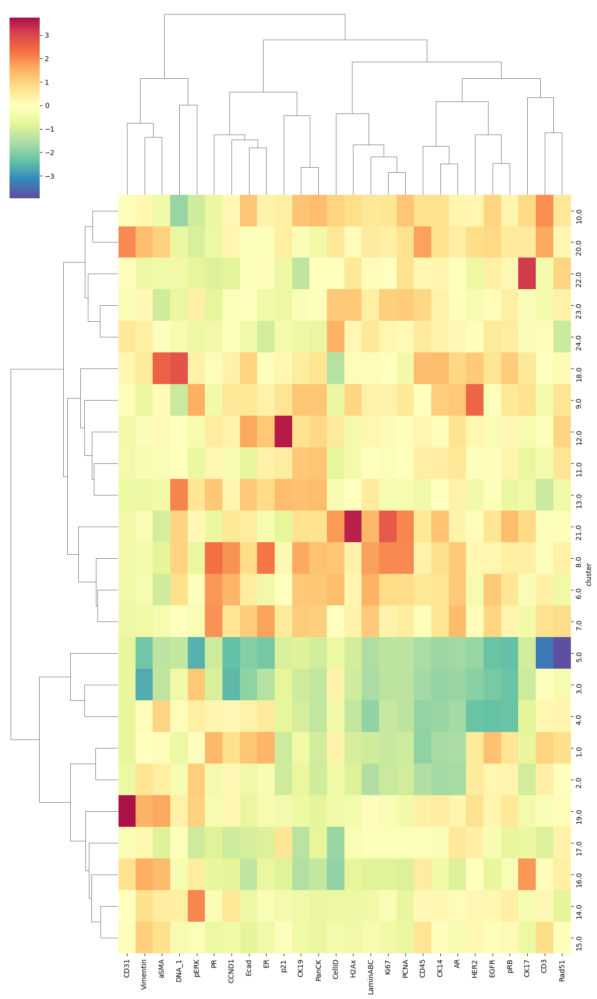

In [31]:
"""
We want to reduce the dataset down to N max clusters, where N is approximately 25 clusters. To achieve this, we will leave the last 25 clusters remaining.

"""

""" MAKE MARKER HEATMAP PLOT """
"""
To access the reordered row indices, use: clustergrid.dendrogram_row.reordered_ind
Column indices, use: clustergrid.dendrogram_col.reordered_ind
"""
color_by = "cluster"

import matplotlib.pyplot as plt
drop_cols = ['core', 'cross_cluster','cluster', 'CellID'] + metadata_list
drop_cols = [x for x in drop_cols if x != color_by]
drop_cols = [x for x in drop_cols if x in tumor_all_recombined.columns.to_list()]

#good_col_names = pd.read_csv('/home/groups/CEDAR/eddyc/projects/cyc_IF/UMAP/data/Normalized Mean Intensities_processed_robust_CE.csv', index_col=0, nrows=0).columns.tolist()[:-1] #exclude 'Sample'
tumor_all_recombined_remapped = tumor_all_recombined.copy()
tumor_all_recombined_remapped['cluster'] = tumor_all_recombined_remapped['cluster'].map(tumor_assignments)

hh = sns.clustermap(tumor_all_recombined_remapped.reset_index().drop(drop_cols, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tumor_all_{}_combined_heatmap.pdf".format(color_by), format='pdf')

## Same Visualizations, but for the immune dataset!

In [14]:
#read the CSV
immune_all_recombined = pd.read_csv("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/immune_all_labeled.csv", delimiter=",")
immune_all_recombined.set_index(["CellID", "core"], inplace=True)
immune_all_recombined.sort_index(inplace=True)
immune_all_recombined.drop_duplicates(inplace=True) #same as below.
print(immune_all_recombined.shape)
immune_all_recombined.head()


(313106, 27)


DNA_1       CD3      PDL1      GRZB      Ki67     PanCK  \
CellID core                                                               
1      A10   0.544020  0.252290  0.219375  0.295454  0.272837  0.789114   
       B07   0.414268  0.091615  0.181223  0.250201  0.195712  0.666194   
       B09   0.151202  0.049139  0.083111  0.224157  0.159503  0.112485   
       D02   0.503489  0.292647  0.340063  0.373820  0.370994  0.279525   
       E03   0.875082  0.242098  0.192490  0.379199  0.262782  0.095148   

                 CD45      CD68      CD3d      CD8a  ...       pRB       PD1  \
CellID core                                          ...                       
1      A10   0.261185  0.262720  0.298458  0.154739  ...  0.284653  0.392452   
       B07   0.244429  0.198028  0.123569  0.140504  ...  0.226982  0.331773   
       B09   0.203474  0.182500  0.141604  0.130949  ...  0.210774  0.317879   
       D02   0.323031  0.296904  0.331605  0.280851  ...  0.323684  0.353607   
       E03   0.270920  0.278376  0.388238  0.241546  ...  0.378463  0.399237   

             LaminABC    PDL1_3      LAG3      CD20     HLA_A  MHC_II_DPB1  \
CellID core                                                                  
1      A10   0.094943  0.073724  0.311875  0.127894  0.126329     0.094604   
       B07   0.179451  0.139051  0.312292  0.109289  0.225616     0.246570   
       B09   0.104898  0.038887  0.252355  0.141246  0.277237     0.129719   
       D02   0.190228  0.177627  0.337103  0.069763  0.209349     0.076919   
       E03   0.193747  0.280796  0.423543  0.177688  0.278397     0.130757   

             cluster  cross_cluster  
CellID core                          
1      A10         8             -1  
       B07         8              1  
       B09        31              1  
       D02         1              1  
       E03         1              1  

[5 rows x 27 columns]

In [26]:
"""
RUN UMAP
"""
import time
np.random.seed(0)

start = time.time()
umap = cuml.UMAP(n_neighbors=20)
drop_list = ['cross_cluster','cluster','core', 'CellID'] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x in immune_all_recombined.columns.to_list()]
umap_embed = umap.fit_transform(immune_all_recombined.drop(drop_list,axis=1))#.rename(columns={0:'UMAP1',1:'UMAP2'})
end = time.time()
print("Total UMAP training time = {}".format(end-start))

Total UMAP training time = 8.844358682632446


In [34]:
 
#### SET COLOR BY SCHEME ####
color_by = "cluster"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
if color_by in immune_all_recombined.reset_index().columns.tolist():
    umap_coords = pd.concat([umap_coords,immune_all_recombined.reset_index()[keep_inds][color_by]], axis=1)
else:
    print("Adding metadata...")
    umap_coords[color_by] = metadata.set_index('core').loc[immune_all_recombined.reset_index()['core']][color_by].values
    print("Complete.")
#umap_coords = pd.concat([umap_coords,tumor_all.reset_index()[keep_inds][color_by]], axis=1)

#########################################

#############################
metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']
good_name_list = ["cluster", "core", "cross_cluster"] + metadata_list

if color_by in good_name_list
    assert color_by in good_name_list, "'{}' must be one of the following: {}".format(color_by, good_name_list)
    
    if color_by in ['cluster', 'cross_cluster', 'core']:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords['{}'.format(color_by)].unique()))]
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
    elif color_by in metadata_list:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(metadata[color_by].unique()))]
        #add the correct data column
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
        
    umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                           aggregator=ds.count_cat(color_by),
                           color_key=color_key).opts(padding=0.1,
                                                     xaxis=None,
                                                     yaxis=None,
                                                     width=700,
                                                     height=700,
                                                     legend_position='right'))

else:
    if color_by in immune_all_recombined.columns.tolist():
        #probably continuous. 
        umap_coords = pd.concat([umap_coords,immune_all_recombined.reset_index()[keep_inds]['cluster']], axis=1)
        cluster_dta = umap_coords.groupby('cluster').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
        
        umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=10),
                       aggregator=ds.mean(color_by),
                       cmap = fire).opts(padding=0.1,
                             xaxis=None,
                             yaxis=None,
                             width=700,
                             height=700))

umap_ds*labels

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

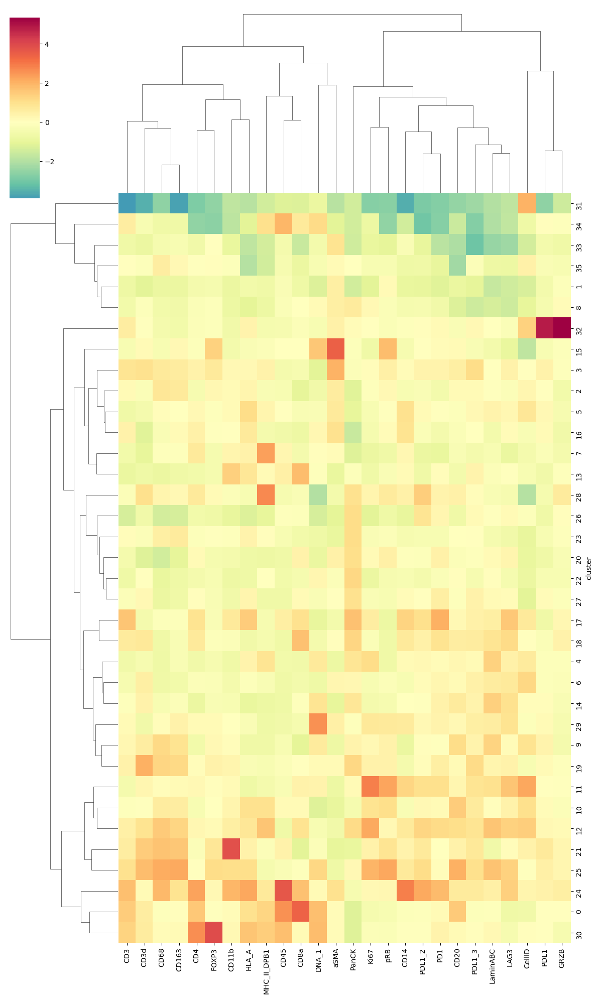

In [15]:
""" MAKE MARKER HEATMAP PLOT """

color_by = 'cluster'

import matplotlib.pyplot as plt
metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']

drop_cols = ['core', 'cross_cluster','cluster', 'CellID']
drop_cols = [x for x in drop_cols if x != color_by]
drop_cols = [x for x in drop_cols if x in immune_all_recombined.columns.to_list()]
#good_col_names = pd.read_csv('/home/groups/CEDAR/eddyc/projects/cyc_IF/UMAP/data/Normalized Mean Intensities_processed_robust_CE.csv', index_col=0, nrows=0).columns.tolist()[:-1] #exclude 'Sample'
g = sns.clustermap(immune_all_recombined.reset_index().drop(drop_cols, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/immune_all_{}_heatmap.pdf".format(color_by), format='pdf')

In [16]:
from scipy.cluster.hierarchy import fcluster

KK = g.dendrogram_row.linkage
"""
A (n-1) by 4 matrix Z is returned. At the i-th iteration, clusters with indices Z[i, 0] and Z[i, 1] are combined to form cluster n+i. 
A cluster with an index less than n corresponds to one of the n original observations. The distance between clusters Z[i, 0] and Z[i, 1] 
is given by Z[i, 2]. The fourth value Z[i, 3] represents the number of original observations in the newly formed cluster.
"""

MAX_CLUSTERS = 24
clust = fcluster(KK, MAX_CLUSTERS, criterion='maxclust')


immune_assignments = np.concatenate([np.expand_dims(np.array(list(range(np.max(immune_all_recombined['cluster'])+1))),axis=-1), np.expand_dims(clust,axis=-1)], axis=-1)
immune_assignments = {x:int(y) for [x,y] in immune_assignments}

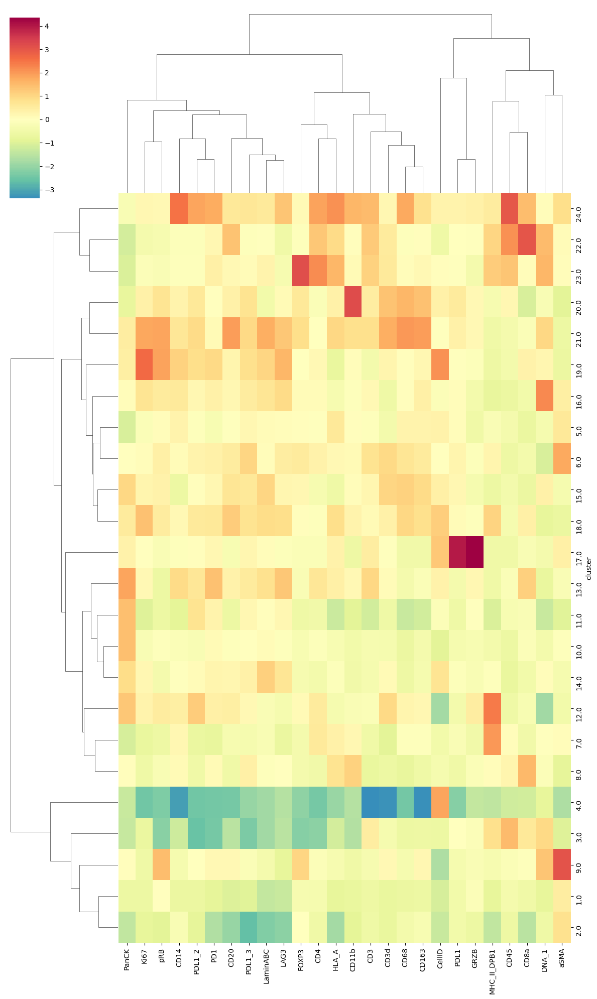

In [17]:
"""
We want to reduce the dataset down to N max clusters, where N is approximately 25 clusters. To achieve this, we will leave the last 25 clusters remaining.

"""

""" MAKE MARKER HEATMAP PLOT """
"""
To access the reordered row indices, use: clustergrid.dendrogram_row.reordered_ind
Column indices, use: clustergrid.dendrogram_col.reordered_ind
"""
color_by = "cluster"

import matplotlib.pyplot as plt
drop_cols = ['core', 'cross_cluster','cluster', 'CellID'] + metadata_list
drop_cols = [x for x in drop_cols if x != color_by]
drop_cols = [x for x in drop_cols if x in immune_all_recombined.columns.to_list()]

#good_col_names = pd.read_csv('/home/groups/CEDAR/eddyc/projects/cyc_IF/UMAP/data/Normalized Mean Intensities_processed_robust_CE.csv', index_col=0, nrows=0).columns.tolist()[:-1] #exclude 'Sample'
immune_all_recombined_remapped = immune_all_recombined.copy()
immune_all_recombined_remapped['cluster'] = immune_all_recombined_remapped['cluster'].map(immune_assignments)

hh = sns.clustermap(immune_all_recombined_remapped.reset_index().drop(drop_cols, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/immune_all_{}_combined_heatmap.pdf".format(color_by), format='pdf')

### Do the UMAP visualizations for the tracked cells!

In [18]:
tracked = pd.read_parquet("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/clustering_files/all_tracked_100NN_leiden.parquet")
tracked['core'] = tracked['core'].apply(pad_with_zero)
tracked.head()

,tumor_CellID,core,tumor_DNA_1,tumor_CD3,tumor_pERK,tumor_Rad51,tumor_CCND1,tumor_Vimentin,tumor_aSMA,tumor_Ecad,...,immune_pRB,immune_PD1,immune_LaminABC,immune_PDL1_3,immune_LAG3,immune_CD20,immune_HLA_A,immune_MHC_II_DPB1,immune_cluster,combined_cluster
0,4,A10,0.593081,0.097794,0.424482,0.563529,0.058098,0.117817,0.208956,0.209028,...,0.227520,0.354637,0.254677,0.207973,0.355188,0.161698,0.136356,0.147194,8,32
1,16,A10,0.658031,0.213788,0.455652,0.712999,0.015734,0.072038,0.203733,0.138789,...,0.259270,0.413546,0.121441,0.080611,0.244399,0.148267,0.117561,0.099980,8,32
2,7,A10,0.449218,0.024707,0.207250,0.256236,0.008818,0.064301,0.191977,0.140377,...,0.193292,0.331904,0.159242,0.281982,0.353703,0.155447,0.124792,0.118188,8,32
3,23,A10,0.233838,0.017092,0.204227,0.243604,0.018824,0.078568,0.191108,0.144855,...,0.242829,0.404079,0.128072,0.117140,0.279830,0.115456,0.102553,0.083562,8,32
4,20,A10,0.656867,0.253500,0.474569,0.721957,0.459799,0.313952,0.386038,0.728411,...,0.245150,0.408680,0.369294,0.351547,0.478649,0.198376,0.178982,0.139121,22,-1


In [8]:
"""
RUN UMAP
"""
import time
np.random.seed(0)

start = time.time()
umap = cuml.UMAP(n_neighbors=20)
drop_list = ['cross_cluster','combined_cluster','cluster','core', 'CellID'] + ["{}_{}".format(x,y) for x in ['tumor', 'immune'] for y in ['cluster','CellID']] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x in tracked.columns.to_list()]
umap_embed = umap.fit_transform(tracked.drop(drop_list,axis=1))#.rename(columns={0:'UMAP1',1:'UMAP2'})
end = time.time()
print("Total UMAP training time = {}".format(end-start))

Total UMAP training time = 3.746223211288452


In [94]:
metadata.set_index('core').loc[tracked['core']]

,HTAN Participant ID,Age,Sex,Anat. Site,Pathology,Grade,Clinic stage (TNM),Subtype,Pantomics Ref. No.
core,,,,,,,,,
A10,HTA14_10,48,F,Breast,Invasive ductal carcinoma,I,T1N1M0,Luminal A,F10-1047
A10,HTA14_10,48,F,Breast,Invasive ductal carcinoma,I,T1N1M0,Luminal A,F10-1047
A10,HTA14_10,48,F,Breast,Invasive ductal carcinoma,I,T1N1M0,Luminal A,F10-1047
A10,HTA14_10,48,F,Breast,Invasive ductal carcinoma,I,T1N1M0,Luminal A,F10-1047
A10,HTA14_10,48,F,Breast,Invasive ductal carcinoma,I,T1N1M0,Luminal A,F10-1047
...,...,...,...,...,...,...,...,...,...
H09,HTA14_15,68,M,Jejunum,Normal Jejunum,NaN,NaN,NormalJejunum,F17-3395
H09,HTA14_15,68,M,Jejunum,Normal Jejunum,NaN,NaN,NormalJejunum,F17-3395
H09,HTA14_15,68,M,Jejunum,Normal Jejunum,NaN,NaN,NormalJejunum,F17-3395


In [99]:
 
#### SET COLOR BY SCHEME ####
color_by = "Pathology" #combined_cluster"

### Convert the data back to a pandas dataframe.
umap_coords = pd.DataFrame(data = umap_embed, columns = ["UMAP1","UMAP2"])

####REMOVE OUTLIERS FOR A BETTER PLOT####
keep_inds = (np.abs(stats.zscore(umap_coords)) < 5).all(axis=1)
umap_coords = umap_coords[keep_inds]
if color_by in tracked.reset_index().columns.tolist():
    umap_coords = pd.concat([umap_coords,tracked.reset_index()[keep_inds][color_by]], axis=1)
else:
    print("Adding metadata...")
    umap_coords[color_by] = metadata.set_index('core').loc[tracked['core']][color_by].values
    print("Complete.")

#########################################

#############################
metadata_list = ['Grade', 'Pathology', 'Anat. Site', 'Age', 'HTAN Participant ID', 'Clinic stage (TNM)', 'Subtype']
good_name_list = ["combined_cluster", "core", "tumor_cluster", "immune_cluster"] + metadata_list

if color_by in good_name_list:
    assert color_by in good_name_list, "'{}' must be one of the following: {}".format(color_by, good_name_list)
    
    if color_by in ["tumor_cluster", "immune_cluster", "combined_cluster"]:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(umap_coords["{}".format(color_by)].unique()))]
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
    elif color_by in metadata_list:
        color_key = ['#%02x%02x%02x' % tuple(int(255*j) for j in glasbey_hv[i]) for i in range(len(metadata[color_by].unique()))]
        #add the correct data column
        cluster_dta = umap_coords.groupby(color_by).mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
    
        
    umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=20),
                           aggregator=ds.count_cat(color_by),
                           color_key=color_key).opts(padding=0.1,
                                                     xaxis=None,
                                                     yaxis=None,
                                                     width=700,
                                                     height=700,
                                                     legend_position='right'))



else:
    if color_by in tracked.columns.tolist():
        #probably continuous. 
        umap_coords = pd.concat([umap_coords,tracked.reset_index()[keep_inds]['combined_cluster']], axis=1)
        cluster_dta = umap_coords.groupby('combined_cluster').mean()
        labels = hv.Labels({('UMAP1', 'UMAP2'): cluster_dta.to_numpy(), 'text': cluster_dta.index.tolist()}, ['UMAP1', 'UMAP2'], 'text')
        
        umap_ds = dynspread(datashade(hv.Scatter(umap_coords).opts(size=10),
                       aggregator=ds.mean(color_by),
                       cmap = fire).opts(padding=0.1,
                             xaxis=None,
                             yaxis=None,
                             width=700,
                             height=700))

umap_ds*labels

Adding metadata...
Complete.


:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [UMAP1,UMAP2]   (R,G,B,A)
      .Labels.I :Labels   [UMAP1,UMAP2]   (text)

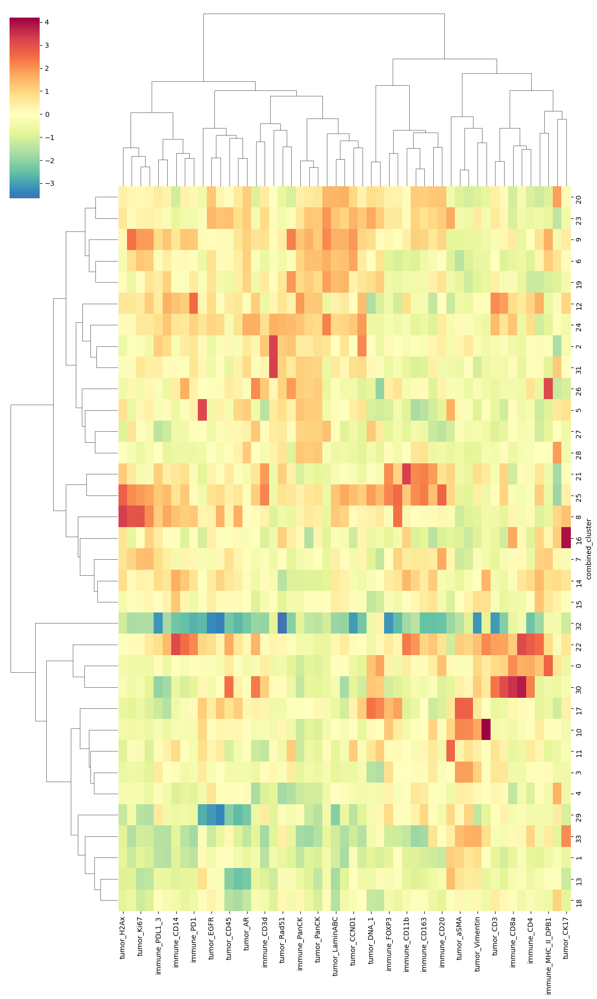

In [19]:
""" MAKE MARKER HEATMAP PLOT """

color_by = 'combined_cluster'

import matplotlib.pyplot as plt
drop_list = ['cross_cluster','combined_cluster','cluster','core', 'CellID'] + ["{}_{}".format(x,y) for x in ['tumor', 'immune'] for y in ['cluster','CellID']] #include any of the columns that shouldn't be used for clustering here.
drop_list = [x for x in drop_list if x != color_by]
drop_list = [x for x in drop_list if x in tracked.columns.to_list()]

g = sns.clustermap(tracked.reset_index().drop(drop_list, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tracked_{}_heatmap.pdf".format(color_by), format='pdf')

In [22]:
from scipy.cluster.hierarchy import fcluster

KK = g.dendrogram_row.linkage
"""
A (n-1) by 4 matrix Z is returned. At the i-th iteration, clusters with indices Z[i, 0] and Z[i, 1] are combined to form cluster n+i. 
A cluster with an index less than n corresponds to one of the n original observations. The distance between clusters Z[i, 0] and Z[i, 1] 
is given by Z[i, 2]. The fourth value Z[i, 3] represents the number of original observations in the newly formed cluster.
"""

MAX_CLUSTERS = 24
clust = fcluster(KK, MAX_CLUSTERS, criterion='maxclust')


tracked_assignments = np.concatenate([np.expand_dims(np.array(list(range(np.max(tracked['combined_cluster'])+1))),axis=-1), np.expand_dims(clust,axis=-1)], axis=-1)
tracked_assignments = {x:int(y) for [x,y] in tracked_assignments}

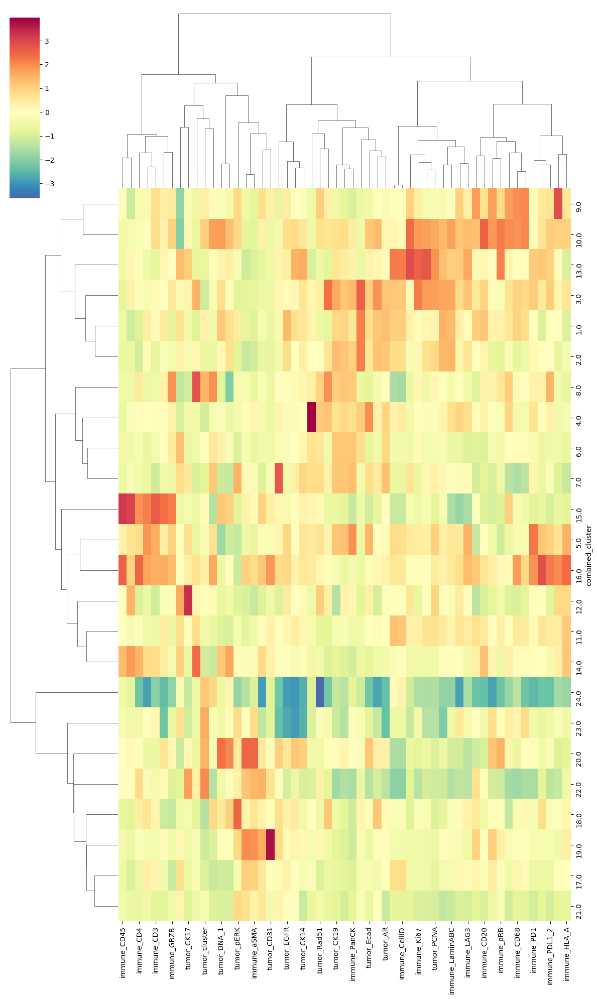

In [26]:
"""
We want to reduce the dataset down to N max clusters, where N is approximately 25 clusters. To achieve this, we will leave the last 25 clusters remaining.

"""

""" MAKE MARKER HEATMAP PLOT """
"""
To access the reordered row indices, use: clustergrid.dendrogram_row.reordered_ind
Column indices, use: clustergrid.dendrogram_col.reordered_ind
"""
color_by = "combined_cluster"

import matplotlib.pyplot as plt
drop_list = ['cross_cluster','combined_cluster','cluster','core', 'CellID'] + ["{}_{}".format(x,y) for x in ['tumor', 'immune'] for y in ['cluster','CellID']] #include any of the columns that shouldn't be used for clustering here.
drop_cols = [x for x in drop_cols if x != color_by]
drop_cols = [x for x in drop_cols if x in tracked.columns.to_list()]

#good_col_names = pd.read_csv('/home/groups/CEDAR/eddyc/projects/cyc_IF/UMAP/data/Normalized Mean Intensities_processed_robust_CE.csv', index_col=0, nrows=0).columns.tolist()[:-1] #exclude 'Sample'
tracked_remapped = tracked.copy()
tracked_remapped['combined_cluster'] = tracked_remapped['combined_cluster'].map(tracked_assignments)

hh = sns.clustermap(tracked_remapped.reset_index().drop(drop_cols, axis=1).groupby(color_by).mean().drop(-1.0,errors='ignore'),
                   z_score=1,
                   cmap='Spectral_r',
                   method='ward',
                   center=0,
                   figsize=(12,20))

plt.savefig("/home/groups/CEDAR/eddyc/projects/TNP/data/all_data/tracked_{}_combined_heatmap.pdf".format(color_by), format='pdf')

## Investigate Sankey Plots
Do so AFTER doing the dendrogram tree cutting to reduce the number of clusters!

#### Do the Sankey plot for the tumor only data

In [41]:
""" MAKE SANKEY PLOT """
#import cudf
#tumor_all_recombined = cudf.from_pandas(tumor_all_recombined) 
print("turning into sankey data")

tumor_all_recombined_remapped['cross_cluster'] = tumor_all_recombined_remapped['cross_cluster'].map(tracked_assignments)

tumor_all_sankey_dta = tumor_all_recombined_remapped[['cluster','cross_cluster']].groupby(tumor_all_recombined_remapped[['cluster','cross_cluster']].columns.tolist(),as_index=False).size()

# tumor_all_sankey_dta = tumor_all_sankey_dta.to_frame().reset_index()
# tumor_all_sankey_dta['cluster'] = ['T:{}'.format(x) for x in tumor_all_sankey_dta['cluster'].astype(str).to_pandas()]
# tumor_all_sankey_dta['cross_cluster'] = ['C:{}'.format(x) for x in tumor_all_sankey_dta['cross_cluster'].astype(str).to_pandas()]

tumor_all_sankey_dta = tumor_all_sankey_dta.reset_index()
bad_cols = ['index']
bad_cols = [x for x in bad_cols if x in tumor_all_sankey_dta.columns]
tumor_all_sankey_dta = tumor_all_sankey_dta.drop(bad_cols, axis=1)
tumor_all_sankey_dta['cluster'] = ['T:{}'.format(x) for x in tumor_all_sankey_dta['cluster'].astype(str)]
tumor_all_sankey_dta['cross_cluster'] = ['C:{}'.format(x) for x in tumor_all_sankey_dta['cross_cluster'].astype(str)]


turning into sankey data


In [48]:
tracked_assignments

{0: 14,
 1: 21,
 2: 4,
 3: 17,
 4: 17,
 5: 7,
 6: 2,
 7: 11,
 8: 13,
 9: 3,
 10: 19,
 11: 18,
 12: 5,
 13: 21,
 14: 11,
 15: 11,
 16: 12,
 17: 20,
 18: 21,
 19: 2,
 20: 1,
 21: 9,
 22: 16,
 23: 1,
 24: 4,
 25: 10,
 26: 8,
 27: 6,
 28: 6,
 29: 23,
 30: 15,
 31: 4,
 32: 24,
 33: 22}

In [42]:
tumor_all_sankey_dta.head()

,cluster,cross_cluster,size
0,T:1.0,C:1.0,173
1,T:1.0,C:2.0,21
2,T:1.0,C:3.0,1
3,T:1.0,C:4.0,1129
4,T:1.0,C:7.0,2


In [47]:
tumor_all_sankey_dta.sort_values("size").head(10)

,cluster,cross_cluster,size
227,T:17.0,C:3.0,1
49,T:4.0,C:18.0,1
23,T:2.0,C:19.0,1
276,T:20.0,C:13.0,1
277,T:20.0,C:16.0,1
134,T:10.0,C:16.0,1
128,T:10.0,C:5.0,1
117,T:9.0,C:13.0,1
152,T:11.0,C:19.0,1
283,T:21.0,C:1.0,1


In [43]:
# sankey = hv.Sankey(tumor_all_sankey_dta.to_pandas().to_numpy(), label='Tumor type to Combined Panel Type') ### Crashes. Memory leak problem?

sankey = hv.Sankey(tumor_all_sankey_dta.to_numpy(), label='Tumor type to Combined Panel Type') ### Crashes. Memory leak problem?
# Need an alternative to do the 
sankey

:Sankey   [start,end]   (Value)

#### Do the same for the immune dataset

In [45]:
""" MAKE SANKEY PLOT """
# import cudf
#immune_all_recombined = cudf.from_pandas(immune_all_recombined) 
print("turning into sankey data")
immune_all_recombined_remapped['cross_cluster'] = immune_all_recombined_remapped['cross_cluster'].map(tracked_assignments)

immune_all_sankey_dta = immune_all_recombined_remapped[['cluster','cross_cluster']].groupby(immune_all_recombined_remapped[['cluster','cross_cluster']].columns.tolist(),as_index=False).size()

immune_all_sankey_dta = immune_all_sankey_dta.reset_index()
bad_cols = ['index']
bad_cols = [x for x in bad_cols if x in immune_all_sankey_dta.columns]
immune_all_sankey_dta = immune_all_sankey_dta.drop(bad_cols, axis=1)

immune_all_sankey_dta['cluster'] = ['I:{}'.format(x) for x in immune_all_sankey_dta['cluster'].astype(str)]
immune_all_sankey_dta['cross_cluster'] = ['C:{}'.format(x) for x in immune_all_sankey_dta['cross_cluster'].astype(str)]
# immune_all_sankey_dta = immune_all_sankey_dta.to_frame().reset_index()
# immune_all_sankey_dta['cluster'] = ['I:{}'.format(x) for x in immune_all_sankey_dta['cluster'].astype(str).to_pandas()]
# immune_all_sankey_dta['cross_cluster'] = ['C:{}'.format(x) for x in immune_all_sankey_dta['cross_cluster'].astype(str).to_pandas()]


turning into sankey data


In [46]:
# sankey = hv.Sankey(immune_all_sankey_dta.to_pandas().to_numpy(), label='Immune Type to Combined Panel Type')
sankey = hv.Sankey(immune_all_sankey_dta.to_numpy(), label='Immune Type to Combined Panel Type')

# Need an alternative to do the 
sankey

:Sankey   [start,end]   (Value)

#### Finally, do the Sankey plot for the tracked data
We should have also remapped the tumor only clusters and the immune only clusters after the dendrogram cutting for the tracked cell tumor_cluster and immune_cluster labels.

In [32]:

""" MAKE SANKEY PLOT """
# import cudf
# tracked = cudf.from_pandas(tracked) 
print("Turning tumor tracked data into sankey Sankey...")

tracked_remapped['immune_cluster'] = tracked_remapped['immune_cluster'].map(immune_assignments)
tracked_remapped['tumor_cluster'] = tracked_remapped['tumor_cluster'].map(tumor_assignments)

tracked_im_sankey_dta = tracked_remapped[['immune_cluster','combined_cluster']].groupby(tracked_remapped[['immune_cluster','combined_cluster']].columns.tolist(),as_index=False).size()

# tracked_im_sankey_dta = tracked_im_sankey_dta.to_frame().reset_index()
# tracked_im_sankey_dta['immune_cluster'] = ['I:{}'.format(x) for x in tracked_im_sankey_dta['immune_cluster'].astype(str).to_pandas()]
# tracked_im_sankey_dta['combined_cluster'] = ['C:{}'.format(x) for x in tracked_im_sankey_dta['combined_cluster'].astype(str).to_pandas()]
#tracked_im_sankey_dta = tracked_im_sankey_dta.reset_index()
tracked_im_sankey_dta['immune_cluster'] = ['I:{}'.format(x) for x in tracked_im_sankey_dta['immune_cluster'].astype(str)]
tracked_im_sankey_dta['combined_cluster'] = ['C:{}'.format(x) for x in tracked_im_sankey_dta['combined_cluster'].astype(str)]

print("Turning immune tracked data into Sankey...")
tracked_tu_sankey_dta = tracked[['immune_cluster','combined_cluster']].groupby(tracked[['immune_cluster','combined_cluster']].columns.tolist(),as_index=False).size()
# tracked_tu_sankey_dta = tracked_tu_sankey_dta.to_frame().reset_index()
# tracked_tu_sankey_dta['immune_cluster'] = ['I:{}'.format(x) for x in tracked_tu_sankey_dta['immune_cluster'].astype(str).to_pandas()]
# tracked_tu_sankey_dta['combined_cluster'] = ['C:{}'.format(x) for x in tracked_tu_sankey_dta['combined_cluster'].astype(str).to_pandas()]
#tracked_tu_sankey_dta = tracked_tu_sankey_dta.reset_index()
tracked_tu_sankey_dta['immune_cluster'] = ['I:{}'.format(x) for x in tracked_tu_sankey_dta['immune_cluster'].astype(str)]
tracked_tu_sankey_dta['combined_cluster'] = ['C:{}'.format(x) for x in tracked_tu_sankey_dta['combined_cluster'].astype(str)]

tracked_im_sankey_dta.head()


Turning tumor tracked data into sankey Sankey...
Turning immune tracked data into Sankey...


,immune_cluster,combined_cluster,size
0,I:1.0,C:1.0,65
1,I:1.0,C:2.0,23
2,I:1.0,C:3.0,129
3,I:1.0,C:4.0,173
4,I:1.0,C:5.0,69


In [38]:
tracked_im_sankey_dta.sort_values("size").head(20)

,immune_cluster,combined_cluster,size
82,I:8.0,C:11.0,1
80,I:8.0,C:9.0,1
30,I:5.0,C:8.0,1
241,I:19.0,C:22.0,1
248,I:20.0,C:5.0,1
249,I:20.0,C:6.0,1
250,I:20.0,C:7.0,1
50,I:6.0,C:20.0,1
238,I:19.0,C:19.0,1
255,I:20.0,C:17.0,1


In [33]:
#sankey = hv.Sankey(tracked_im_sankey_dta.to_pandas().to_numpy(), label='Immune Type to Combined Panel Type')
sankey = hv.Sankey(tracked_im_sankey_dta.to_numpy(), label='Immune Type to Combined Panel Type')

# Need an alternative to do the 
sankey

:Sankey   [start,end]   (Value)

In [34]:
# sankey = hv.Sankey(tracked_tu_sankey_dta.to_pandas().to_numpy(), label='Tumor Type to Combined Panel Type')
sankey = hv.Sankey(tracked_tu_sankey_dta.to_numpy(), label='Tumor Type to Combined Panel Type')

# Need an alternative to do the 
sankey

:Sankey   [start,end]   (Value)